In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from pandas import DataFrame as df
from pandas import Series as sr

from sklearn.model_selection import StratifiedShuffleSplit as strat
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.preprocessing import PolynomialFeatures

import warnings
warnings.filterwarnings('ignore') # IGNORE DEPRECATION (AND OTHER WARNINGS).

In [2]:
# IMPORTING DATA.
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

In [3]:
features = train.copy()
labels = train['label']
test_features = test.copy()

In [4]:
features.head()

,label,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,...,pixel774,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [5]:
print(features.shape, labels.shape)

(42000, 785) (42000,)


In [6]:
# SPLITTING ORIGINAL TRAINING DATA INTO TRAINING AND VALIDATION DATA IN A STRATIFIED MANNER.
split = strat(test_size=0.2, random_state=42)
for train_indices, valid_indices in split.split(features, features['label']):
    strat_train = features.loc[train_indices]
    strat_test = features.loc[valid_indices]

In [8]:
# PREPARING DATA.
strat_train_x = strat_train.copy()
strat_train_x.drop(['label'], axis=1, inplace=True)
strat_train_y = strat_train['label']

strat_test_x = strat_test.copy()
strat_test_x.drop(['label'], axis=1, inplace=True)
strat_test_y = strat_test['label']

In [9]:
# CONVERTING ALL DATAFRAMES TO NUMPY ARRAYS FOR FAST COMPUTATIONS.
strat_train_x = np.array(strat_train_x)
strat_train_y = np.array(strat_train_y)
strat_test_x = np.array(strat_test_x)
strat_test_y = np.array(strat_test_y)
test_features = np.array(test_features)
print(strat_train_x.shape, strat_train_y.shape, strat_test_x.shape, strat_test_y.shape, \
     test_features.shape)

(33600, 784) (33600,) (8400, 784) (8400,) (28000, 784)


In [10]:
def plot_images(images, true, pred=None):
    figure = plt.figure( figsize = ( 15, 15 ) )

    for i in range(len(images)) :
        ax = figure.add_subplot( 3, 3, i + 1 )
        ax.imshow( images[i, :].reshape(28, 28), cmap = 'binary' )
        if pred is None:
            ax.set_xlabel('True Label : {0}'.format(np.argmax(true[i])))
        else:
            ax.set_xlabel('True Label : {0}, Prediction : {1}'.format(true[i], pred[i]))
        ax.set_xticks([])
        ax.set_yticks([])

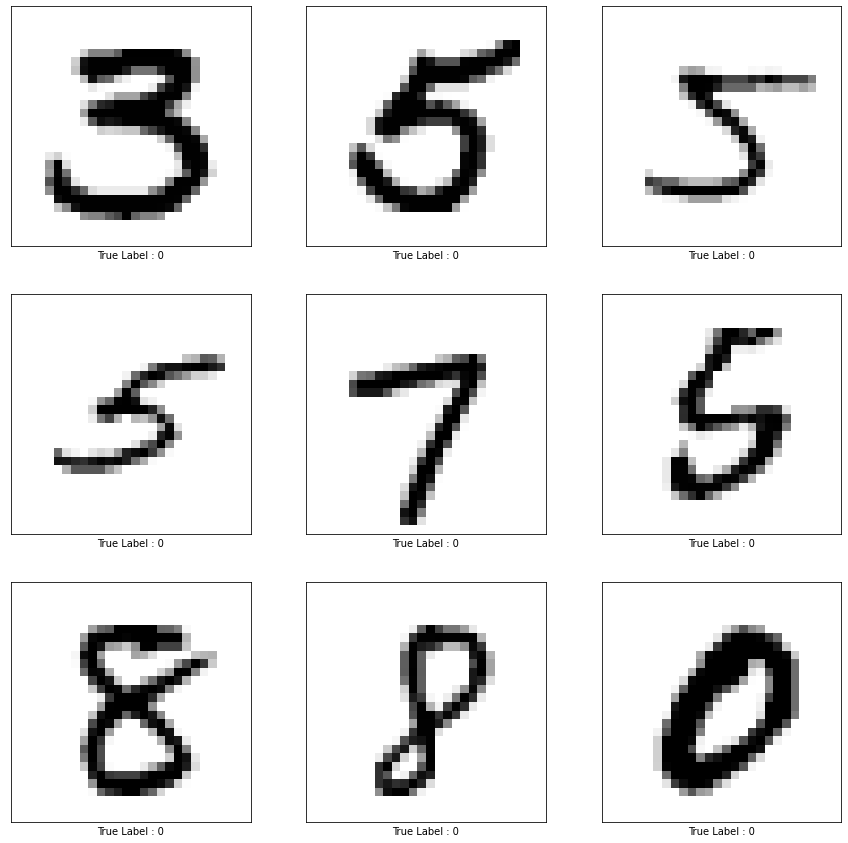

In [11]:
# PLOTTING FIRST NINE IMAGES WITH TRUE LABELS.
plot_images(strat_train_x[0:9, :], strat_train_y[0:9]) 

In [12]:
# COUNTS OF EACH DIGIT IN THE TRAINING SET.
label_counts = labels.value_counts()
label_counts.sort_index(inplace=True)
label_counts

0    4132
1    4684
2    4177
3    4351
4    4072
5    3795
6    4137
7    4401
8    4063
9    4188
Name: label, dtype: int64

<AxesSubplot:>

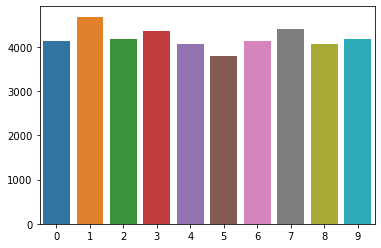

In [13]:
sns.barplot(x=list(range(0,10)), y=list(label_counts))

In [14]:
# CASTING VALUES TO FLOATS SO THAT THEY CAN BE NORMALISED.
strat_train_x = strat_train_x.astype('float32')
strat_test_x = strat_test_x.astype('float32')
test_features = test_features.astype('float32')

# NORMALISING ALL THE FEATURE VALUES.
strat_train_x /= 255 
strat_test_x /= 255
test_features /= 255
# FIRST TIME I HAD USED STANDARD SCALING 'from sklearn.preprocessing import StandardScaler' BUT IT 
# GAVE LESS ACCURACY THAN NORMALISING IN THIS WAY. 

In [15]:
# APPLYING LOGISTIC REGRESSSION DIRECTLY USING 'lbfgs' AS SOLVER.

pred_test = []
log_regression = LogisticRegression(solver='liblinear', max_iter=100)
log_regression_model = log_regression.fit(strat_train_x, strat_train_y)
    
pred_train = log_regression_model.predict(strat_train_x)
pred_valid = log_regression_model.predict(strat_test_x)
pred_test.append(log_regression_model.predict(test_features))
    
acc_train = (pred_train == strat_train_y).mean()
print('Training Set Metrics\n')
print(acc_train)
print('\n')
    
acc_valid = (pred_valid == strat_test_y).mean()
print('Validation Set Metrics\n')
print(acc_valid)
print('\n--------------------------------------------------------------------------------------')
print('\n\n')

Training Set Metrics

0.9327678571428571


Validation Set Metrics

0.9139285714285714

--------------------------------------------------------------------------------------





In [16]:
# ACCURACY IS NOT GOING ABOVE 92%.
# POLYNOMIAL FEATURES CAN BE USED TO INCREASE THE MODEL'S LEARNING POWER AND THUS ACCURACY BUT WITH 
# 250 FEATURES THERE WILL BE MANY POLYNOMIAL FEATURES MAKING IT VERY TIME TAKING TO TRAIN.
# INSTEAD WE WILL CHOOSE 50 BEST FEATURES AND APPLY POLYNOMIAL FEATURES.
pca = PCA(n_components=50, whiten=True)
pca_fit = pca.fit(strat_train_x)

strat_train_x_pca = pca_fit.transform(strat_train_x)
strat_test_x_pca = pca_fit.transform(strat_test_x)
test_features_pca = pca_fit.transform(test_features)

poly = PolynomialFeatures(include_bias=False) # 'incude_bias=False' BECAUSE LOGISTIC REGRESSION
                                              # ITSELF ADDS A BIAS COLUMN.
strat_train_x_pca_poly = poly.fit_transform(strat_train_x_pca)
strat_test_x_pca_poly = poly.fit_transform(strat_test_x_pca)
test_features_pca_poly = poly.fit_transform(test_features_pca)

In [17]:
# NOW APPLYING LOGISTIC REGRESSSION USING 'lbfgs' AS SOLVER ON POLYNOMIAL FEATURES.

pred_test_pca_arr = []


log_regression = LogisticRegression(solver='liblinear', max_iter=100)
log_regression_model = log_regression.fit(strat_train_x_pca_poly, strat_train_y)
    
pred_train_pca = log_regression_model.predict(strat_train_x_pca_poly)
pred_valid_pca = log_regression_model.predict(strat_test_x_pca_poly)
pred_test_pca = log_regression_model.predict(test_features_pca_poly)
pred_test_pca_arr.append(pred_test_pca)
    
acc_train = (pred_train_pca == strat_train_y).mean()
print('Training Set Metrics\n')
print(acc_train)
print('\n')
    
acc_valid = (pred_valid_pca == strat_test_y).mean()
print('Validation Set Metrics\n')
print(acc_valid)
print('\n--------------------------------------------------------------------------------------')
print('\n\n')

Training Set Metrics

1.0


Validation Set Metrics

0.9751190476190477

--------------------------------------------------------------------------------------





In [18]:
#normalization
def normalize_(X,mean,std):
    X_new = (X-mean)/std;
    return X_new

def normalize(X):
    mean = np.mean(X,axis=0);
    std = np.std(X,axis=0);
    std[std < 0.001] =1
    X_new = (X-mean)/std;
    return X_new, mean, std

def prepare_X(X):
    m = X.shape[0]
    ones = np.ones((m, 1))
    X_new = np.column_stack((ones, X))
    return X_new

def sigmoid(z): #where z is column vector
    g = 1/(1+np.exp(z*-1));
    return g

def h(X, theta): #where X is matrix and theta is vector(!)
    z = X.dot(theta)
    return sigmoid(z)

#cost function (штрафна функція)
def cost_function(X, y, theta):
    m = X.shape[0]
    if m ==0:
        return None
    temp =h(X,theta);
    J = sum(-1*y*np.log(temp) - (1-y)*np.log(1-temp) )/m;
    return J

def derivative_theta(X, y, theta):
    m = X.shape[0];
    if m == 0:
        return None
    d_theta = X_new.T.dot(h(X,theta) -y)/m;
    
    return d_theta

#gradient descent (градієнтний спуск)
def gradient_descent(X, y, theta, alpha, epsilon, num_iters, print_J = True):
    m = X.shape[0]
    J_history = [] 
    J = cost_function(X,y,theta);
    
    if print_J == True:
        print(J)
    J_history.append(J)
    for i in range(num_iters):
        theta -= alpha* derivative_theta(X,y,theta);
        J = cost_function(X,y,theta);
        
        J_history.append(J)
        
        if i % 1000 == 0 and print_J == True:
            print(J)
        
        if abs(J-J_history[-2]) < epsilon:
            break
            
    return theta, J_history

#prediction method
def predict(X, mean, std, models,labels):
    
    X_new =normalize_(X,mean,std);
    X_new = prepare_X(X_new);
    predictions = [];
    for theta in models:
        predictions.append(h(X_new,theta))
    
    predict =[];
    for p in range(0,len(predictions[0])):
        max = abs(predictions[0][p]);
        max_label  =labels[0];
        for l in range(1,len(labels)):
            if(abs(predictions[l][p]) > max):
                max = abs(predictions[l][p]);
                max_label  =labels[l];
        predict.append(max_label);
    return predict

In [19]:
strat_train_x = strat_train.copy()
strat_train_x.drop(['label'], axis=1, inplace=True)
strat_train_y = strat_train['label']

strat_test_x = strat_test.copy()
strat_test_x.drop(['label'], axis=1, inplace=True)
strat_test_y = strat_test['label']


X_new, mean, std = normalize(strat_train_x)
X_new = prepare_X(X_new)

In [21]:
from sklearn.preprocessing import OneHotEncoder
enc = OneHotEncoder(handle_unknown='error')
enc.fit(np.array(labels).reshape(-1,1))

y_train_encoded  = enc.transform(np.array(strat_train_y).reshape(-1,1)).toarray()

In [29]:
models =[]
for m in [0,1,2,3,4,5,6,7,8,9]:
    theta = np.zeros((X_new.shape[1], 1))
    y_new =y_train_encoded[:,m].reshape((strat_train_x.shape[0], 1))
    print(y_new.shape)
    new_theta, Js = gradient_descent(X_new, y_new, theta, 0.01, 1e-7, 100, False)
    print("Cost for label ",m," is ",cost_function(X_new, y_new, theta))
    models.append(theta)

(33600, 1)
[[-4.01636905e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.36622664e-06]
 [-5.36622664e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.36622664e-06]
 [-8.75157839e-06]
 [-1.09941205e-05]
 [-1.66174870e-05]
 [-2.05476607e-05]
 [-2.65681419e-05]
 [-2.97634605e-05]
 [-3.14912609e-05]
 [-3.06750858e-05]
 [-3.06869344e-05]
 [-2.87813452e-05]
 [-2.88958353e-05]
 [-2.77551639e-05]
 [-2.50445818e-05]
 [-1.75673218e-05]
 [-1.42555574e-05]
 [-8.71130982e-06]
 [-5.36622664e-06]
 

[[-1.20178007e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.39544486e-05]
 [-1.39544486e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.65541265e-05]
 [-2.60061412e-05]
 [-3.21722366e-05]
 [-5.03689614e-05]
 [-6.47984897e-05]
 [-8.33656523e-05]
 [-9.19348480e-05]
 [-9.32789646e-05]
 [-9.12122217e-05]
 [-9.37248957e-05]
 [-8.74868717e-05]
 [-8.55394916e-05]
 [-8.08249247e-05]
 [-7.26849727e-05]
 [-5.17732337e-05]
 [-4.20232710e-05]
 [-2.42541529e-05]
 [-1.48559749e-05]
 [-1.4855974

[[-2.78693656e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.39675846e-05]
 [-2.39675846e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.92733608e-05]
 [-5.79043239e-05]
 [-6.97660376e-05]
 [-1.16814374e-04]
 [-1.60117780e-04]
 [-2.04623825e-04]
 [-2.20653300e-04]
 [-2.09757858e-04]
 [-2.06840979e-04]
 [-2.22657879e-04]
 [-2.06988105e-04]
 [-1.94127481e-04]
 [-1.78265712e-04]
 [-1.59338491e-04]
 [-1.16432154e-04]
 [-9.44419334e-05]
 [-4.87189009e-05]
 [-2.95275108e-05]
 [-2.9527510

[[-4.34797978e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.65155021e-05]
 [-2.65155021e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.07349080e-05]
 [-8.45882604e-05]
 [-9.95152082e-05]
 [-1.78505433e-04]
 [-2.57793637e-04]
 [-3.27869867e-04]
 [-3.47986402e-04]
 [-3.14702259e-04]
 [-3.13118421e-04]
 [-3.51023469e-04]
 [-3.26437533e-04]
 [-2.96808928e-04]
 [-2.66023206e-04]
 [-2.36400533e-04]
 [-1.76214014e-04]
 [-1.42652753e-04]
 [-6.57036596e-05]
 [-3.94383089e-05]
 [-3.9438308

[[-5.88333207e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.33056594e-05]
 [-2.33056594e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.98385063e-05]
 [-1.05100134e-04]
 [-1.20742778e-04]
 [-2.33594605e-04]
 [-3.53572607e-04]
 [-4.47701471e-04]
 [-4.69200059e-04]
 [-4.07134131e-04]
 [-4.08853451e-04]
 [-4.75746015e-04]
 [-4.43699662e-04]
 [-3.93878986e-04]
 [-3.45579598e-04]
 [-3.05253502e-04]
 [-2.31117849e-04]
 [-1.86543681e-04]
 [-7.62716547e-05]
 [-4.53634415e-05]
 [-4.5363441

[[-7.39341030e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.54907374e-05]
 [-1.54907374e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.61032845e-05]
 [-1.19209197e-04]
 [-1.33486008e-04]
 [-2.81540472e-04]
 [-4.45522751e-04]
 [-5.61501758e-04]
 [-5.82038927e-04]
 [-4.86974403e-04]
 [-4.93679216e-04]
 [-5.95159223e-04]
 [-5.57488492e-04]
 [-4.85523704e-04]
 [-4.17861047e-04]
 [-3.66710832e-04]
 [-2.81110078e-04]
 [-2.26036538e-04]
 [-8.11547904e-05]
 [-4.78257188e-05]
 [-4.7825718

[[-8.87932131e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.91092166e-06]
 [-3.91092166e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.09394520e-04]
 [-1.27090528e-04]
 [-1.38175614e-04]
 [-3.22462229e-04]
 [-5.32885505e-04]
 [-6.68135741e-04]
 [-6.85607037e-04]
 [-5.54664593e-04]
 [-5.67744962e-04]
 [-7.08447494e-04]
 [-6.67081606e-04]
 [-5.71948180e-04]
 [-4.83565821e-04]
 [-4.21375937e-04]
 [-3.26238039e-04]
 [-2.61157824e-04]
 [-8.09470216e-05]
 [-4.72321121e-05]
 [-4.7232112

[[-1.03423299e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.07879039e-05]
 [ 1.07879039e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.19771171e-04]
 [-1.29134891e-04]
 [-1.35440515e-04]
 [-3.56798730e-04]
 [-6.15501528e-04]
 [-7.67278025e-04]
 [-7.79767663e-04]
 [-6.10933261e-04]
 [-6.31509709e-04]
 [-8.15315340e-04]
 [-7.72126633e-04]
 [-6.53400942e-04]
 [-5.43289905e-04]
 [-4.69774507e-04]
 [-3.66639960e-04]
 [-2.92032236e-04]
 [-7.61744011e-05]
 [-4.39277391e-05]
 [-4.3927739

[[-1.17836685e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.80926729e-05]
 [ 2.80926729e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.27395717e-04]
 [-1.25832653e-04]
 [-1.25987045e-04]
 [-3.85121293e-04]
 [-6.93509202e-04]
 [-8.59043025e-04]
 [-8.64800489e-04]
 [-6.56643875e-04]
 [-6.85599417e-04]
 [-9.15778814e-04]
 [-8.72506372e-04]
 [-7.30160405e-04]
 [-5.97567793e-04]
 [-5.12394294e-04]
 [-4.02521791e-04]
 [-3.18853899e-04]
 [-6.73167835e-05]
 [-3.82163948e-05]
 [-3.8216394

[[-1.32044761e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.75872799e-05]
 [ 4.75872799e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.32480226e-04]
 [-1.17704527e-04]
 [-1.10527501e-04]
 [-4.08032276e-04]
 [-7.67182944e-04]
 [-9.43774696e-04]
 [-9.41201129e-04]
 [-6.92700090e-04]
 [-7.30713653e-04]
 [-1.01003385e-03]
 [-9.68248517e-04]
 [-8.02516388e-04]
 [-6.46885048e-04]
 [-5.49694170e-04]
 [-4.34130952e-04]
 [-3.41858322e-04]
 [-5.48136931e-05]
 [-3.03690125e-05]
 [-3.0369012

[[-1.46057855e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 6.89294446e-05]
 [ 6.89294446e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.35254407e-04]
 [-1.05262026e-04]
 [-8.97406557e-05]
 [-4.26112540e-04]
 [-8.36846504e-04]
 [-1.02192531e-03]
 [-1.00956325e-03]
 [-7.19989723e-04]
 [-7.67567481e-04]
 [-1.09837364e-03]
 [-1.05946663e-03]
 [-8.70755623e-04]
 [-6.91682534e-04]
 [-5.82104381e-04]
 [-4.61735170e-04]
 [-3.61300755e-04]
 [-3.90659166e-05]
 [-2.06279182e-05]
 [-2.0627918

[[-1.59885285e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 9.18346290e-05]
 [ 9.18346290e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.35947207e-04]
 [-8.89864326e-05]
 [-6.42522521e-05]
 [-4.39896644e-04]
 [-9.02827440e-04]
 [-1.09398573e-03]
 [-1.07050991e-03]
 [-7.39353787e-04]
 [-7.96857036e-04]
 [-1.18113725e-03]
 [-1.14632211e-03]
 [-9.35152377e-04]
 [-7.32358824e-04]
 [-6.10025237e-04]
 [-4.85607384e-04]
 [-3.77441085e-04]
 [-2.04366028e-05]
 [-9.20968262e-06]
 [-9.2096826

[[-1.73535454e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.16064277e-04]
 [ 1.16064277e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.34776741e-04]
 [-6.93190477e-05]
 [-3.46275039e-05]
 [-4.49863506e-04]
 [-9.65434467e-04]
 [-1.16044607e-03]
 [-1.12465454e-03]
 [-7.51571260e-04]
 [-8.19240510e-04]
 [-1.25867826e-03]
 [-1.22900002e-03]
 [-9.95963192e-04]
 [-7.69272647e-04]
 [-6.33826404e-04]
 [-5.06015741e-04]
 [-3.90533980e-04]
 [ 7.47121827e-07]
 [ 3.69247340e-06]
 [ 3.6924734

[[-1.87015969e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.41416930e-04]
 [ 1.41416930e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.31945301e-04]
 [-4.66580768e-05]
 [-1.37049507e-06]
 [-4.56435360e-04]
 [-1.02494746e-03]
 [-1.22177445e-03]
 [-1.17257995e-03]
 [-7.57353464e-04]
 [-8.35328901e-04]
 [-1.33134609e-03]
 [-1.30769398e-03]
 [-1.05342454e-03]
 [-8.02745742e-04]
 [-6.53847165e-04]
 [-5.23217400e-04]
 [-4.00822878e-04]
 [ 2.41919415e-05]
 [ 1.79064330e-05]
 [ 1.7906433

[[-2.00333740e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.67721352e-04]
 [ 1.67721352e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.27637395e-04]
 [-2.13592629e-05]
 [ 3.50727202e-05]
 [-4.59980927e-04]
 [-1.08161438e-03]
 [-1.27840653e-03]
 [-1.21482809e-03]
 [-7.57344089e-04]
 [-8.45682799e-04]
 [-1.39947546e-03]
 [-1.38259701e-03]
 [-1.10775235e-03]
 [-8.33066018e-04]
 [-6.70397522e-04]
 [-5.37455009e-04]
 [-4.08536647e-04]
 [ 4.96357328e-05]
 [ 3.32790421e-05]
 [ 3.3279042

[[-2.13495075e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.94831146e-04]
 [ 1.94831146e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.22019544e-04]
 [ 6.26151593e-06]
 [ 7.43092466e-05]
 [-4.60820451e-04]
 [-1.13565183e-03]
 [-1.33074135e-03]
 [-1.25189630e-03]
 [-7.52122380e-04]
 [-8.50812746e-04]
 [-1.46338088e-03]
 [-1.45389621e-03]
 [-1.15914271e-03]
 [-8.60490825e-04]
 [-6.83759874e-04]
 [-5.48955019e-04]
 [-4.13888053e-04]
 [ 7.68447562e-05]
 [ 4.96740855e-05]
 [ 4.9674085

[[-2.26505755e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.22620470e-04]
 [ 2.22620470e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.15241048e-04]
 [ 3.59247512e-05]
 [ 1.15993837e-04]
 [-4.59231344e-04]
 [-1.18724743e-03]
 [-1.37914087e-03]
 [-1.28423727e-03]
 [-7.42207909e-04]
 [-8.51181637e-04]
 [-1.52335442e-03]
 [-1.52176982e-03]
 [-1.20777319e-03]
 [-8.85250193e-04]
 [-6.94191014e-04]
 [-5.57927192e-04]
 [-4.17073395e-04]
 [ 1.05610834e-04]
 [ 6.69704065e-05]
 [ 6.6970406

[[-2.39371100e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.50980608e-04]
 [ 2.50980608e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.07435242e-04]
 [ 6.73835302e-05]
 [ 1.59823375e-04]
 [-4.55453744e-04]
 [-1.23656294e-03]
 [-1.42393140e-03]
 [-1.31226097e-03]
 [-7.28065996e-04]
 [-8.47208139e-04]
 [-1.57966523e-03]
 [-1.58638597e-03]
 [-1.25380449e-03]
 [-9.07549891e-04]
 [-7.01924271e-04]
 [-5.64564873e-04]
 [-4.18272864e-04]
 [ 1.35748636e-04]
 [ 8.50601847e-05]
 [ 8.5060184

[[-2.52096028e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.79817206e-04]
 [ 2.79817206e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.87209498e-05]
 [ 1.00419829e-04]
 [ 2.05531680e-04]
 [-4.49695669e-04]
 [-1.28373754e-03]
 [-1.46540623e-03]
 [-1.33633774e-03]
 [-7.10113216e-04]
 [-8.39270543e-04]
 [-1.63256032e-03]
 [-1.64790223e-03]
 [-1.29738215e-03]
 [-9.27574275e-04]
 [-7.07171656e-04]
 [-5.69045708e-04]
 [-4.17651336e-04]
 [ 1.67093139e-04]
 [ 1.03847382e-04]
 [ 1.0384738

[[-2.64685101e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.09048015e-04]
 [ 3.09048015e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.92039669e-05]
 [ 1.34841049e-04]
 [ 2.52884794e-04]
 [-4.42137630e-04]
 [-1.32889102e-03]
 [-1.50382847e-03]
 [-1.35680173e-03]
 [-6.88722675e-04]
 [-8.27710669e-04]
 [-1.68226587e-03]
 [-1.70646587e-03]
 [-1.33863826e-03]
 [-9.45488861e-04]
 [-7.10125927e-04]
 [-5.71532631e-04]
 [-4.15359391e-04]
 [ 1.99497310e-04]
 [ 1.23246355e-04]
 [ 1.2324635

[[-2.77142561e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.38601059e-04]
 [ 3.38601059e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.89784930e-05]
 [ 1.70476880e-04]
 [ 3.01676780e-04]
 [-4.32936658e-04]
 [-1.37212671e-03]
 [-1.53943420e-03]
 [-1.37395438e-03]
 [-6.64228900e-04]
 [-8.12837617e-04]
 [-1.72898886e-03]
 [-1.76221437e-03]
 [-1.37769308e-03]
 [-9.61442625e-04]
 [-7.10962534e-04]
 [-5.72174949e-04]
 [-4.11534435e-04]
 [ 2.32830012e-04]
 [ 1.43180620e-04]
 [ 1.4318062

[[-2.89472371e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.68413110e-04]
 [ 3.68413110e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.81284524e-05]
 [ 2.07176505e-04]
 [ 3.51726057e-04]
 [-4.22229790e-04]
 [-1.41353406e-03]
 [-1.57243532e-03]
 [-1.38806780e-03]
 [-6.36932268e-04]
 [-7.94931263e-04]
 [-1.77291874e-03]
 [-1.81527609e-03]
 [-1.41465643e-03]
 [-9.75570048e-04]
 [-7.09841403e-04]
 [-5.71109474e-04]
 [-4.06301830e-04]
 [ 2.66974138e-04]
 [ 1.63581768e-04]
 [ 1.6358176

[[-3.01678237e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.98428445e-04]
 [ 3.98428445e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.67286922e-05]
 [ 2.44806146e-04]
 [ 4.02872198e-04]
 [-4.10137049e-04]
 [-1.45319090e-03]
 [-1.60302231e-03]
 [-1.39938795e-03]
 [-6.07102963e-04]
 [-7.74245431e-04]
 [-1.81422911e-03]
 [-1.86577101e-03]
 [-1.44962904e-03]
 [-9.87992900e-04]
 [-7.06908555e-04]
 [-5.68461622e-04]
 [-3.99775999e-04]
 [ 3.01824965e-04]
 [ 1.84388512e-04]
 [ 1.8438851

[[-3.13763640e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.28597794e-04]
 [ 4.28597794e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.48460504e-05]
 [ 2.83246922e-04]
 [ 4.54973178e-04]
 [-3.96763976e-04]
 [-1.49116540e-03]
 [-1.63136670e-03]
 [-1.40813744e-03]
 [-5.74984479e-04]
 [-7.51010752e-04]
 [-1.85307936e-03]
 [-1.91381151e-03]
 [-1.48270370e-03]
 [-9.98821801e-04]
 [-7.02297568e-04]
 [-5.64346461e-04]
 [-3.92061467e-04]
 [ 3.37288691e-04]
 [ 2.05545850e-04]
 [ 2.0554585

[[-3.25731852e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.58877476e-04]
 [ 4.58877476e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.25403015e-05]
 [ 3.22392988e-04]
 [ 5.07902991e-04]
 [-3.82203776e-04]
 [-1.52751772e-03]
 [-1.65762331e-03]
 [-1.41451814e-03]
 [-5.40796697e-04]
 [-7.25437201e-04]
 [-1.88961603e-03]
 [-1.95950304e-03]
 [-1.51396620e-03]
 [-1.00815758e-03]
 [-6.96130878e-04]
 [-5.58869683e-04]
 [-3.83253816e-04]
 [ 3.73281168e-04]
 [ 2.27004335e-04]
 [ 2.2700433

[[-3.37585957e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.89228657e-04]
 [ 4.89228657e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.98649859e-05]
 [ 3.62149923e-04]
 [ 5.61549609e-04]
 [-3.66539137e-04]
 [-1.56230140e-03]
 [-1.68193214e-03]
 [-1.41871342e-03]
 [-5.04738579e-04]
 [-6.97716342e-04]
 [-1.92397423e-03]
 [-2.00294480e-03]
 [-1.54349623e-03]
 [-1.01609246e-03]
 [-6.88520941e-04]
 [-5.52128500e-04]
 [-3.73440570e-04]
 [ 4.09726778e-04]
 [ 2.48719440e-04]
 [ 2.4871944

[[-7.75992640e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.22313029e-05]
 [-1.22313029e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.10230875e-05]
 [-1.80726604e-05]
 [-2.29843854e-05]
 [-3.60225159e-05]
 [-4.44773338e-05]
 [-5.71720475e-05]
 [-6.42800752e-05]
 [-6.89762396e-05]
 [-6.72197379e-05]
 [-6.74564759e-05]
 [-6.37075952e-05]
 [-6.49274072e-05]
 [-6.26558052e-05]
 [-5.65653246e-05]
 [-3.93544856e-05]
 [-3.20630293e-05]
 [-1.98006008e-05]
 [-1.22335456e-05]
 [-1.2233545

[[-2.31625688e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.72082770e-05]
 [-3.72082770e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.14840342e-05]
 [-3.60358794e-05]
 [-4.89197060e-05]
 [-9.16446848e-05]
 [-1.12798739e-04]
 [-1.41059872e-04]
 [-1.60816837e-04]
 [-1.82226472e-04]
 [-1.77671456e-04]
 [-1.80914280e-04]
 [-1.75326074e-04]
 [-1.88630461e-04]
 [-1.84759414e-04]
 [-1.66956716e-04]
 [-1.12689234e-04]
 [-9.32199609e-05]
 [-5.97151910e-05]
 [-3.73293536e-05]
 [-3.7329353

[[-3.84046021e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.23869512e-05]
 [-6.23869512e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.11415834e-05]
 [-3.64729978e-05]
 [-5.53659705e-05]
 [-1.32577165e-04]
 [-1.63361526e-04]
 [-1.97730810e-04]
 [-2.28341656e-04]
 [-2.72099069e-04]
 [-2.64852667e-04]
 [-2.74361312e-04]
 [-2.71975931e-04]
 [-3.06242771e-04]
 [-3.02989704e-04]
 [-2.73709186e-04]
 [-1.79767941e-04]
 [-1.50829825e-04]
 [-9.95408714e-05]
 [-6.29438261e-05]
 [-6.2943826

[[-5.34800427e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.74166854e-05]
 [-8.74166854e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.38107917e-05]
 [-2.50268296e-05]
 [-4.84151396e-05]
 [-1.64460287e-04]
 [-2.03588349e-04]
 [-2.37669144e-04]
 [-2.77747291e-04]
 [-3.46433762e-04]
 [-3.36006533e-04]
 [-3.54745150e-04]
 [-3.58657345e-04]
 [-4.19510896e-04]
 [-4.17768574e-04]
 [-3.76984881e-04]
 [-2.41481307e-04]
 [-2.05299636e-04]
 [-1.38914560e-04]
 [-8.88307168e-05]
 [-8.8830716

[[-6.83856212e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.12094370e-04]
 [-1.12094370e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.89983209e-06]
 [-5.35908720e-06]
 [-3.20413422e-05]
 [-1.90661186e-04]
 [-2.37723197e-04]
 [-2.67108979e-04]
 [-3.15641766e-04]
 [-4.10169045e-04]
 [-3.95782170e-04]
 [-4.26366041e-04]
 [-4.38516750e-04]
 [-5.29496551e-04]
 [-5.29363060e-04]
 [-4.76944431e-04]
 [-2.98496164e-04]
 [-2.56924609e-04]
 [-1.77625411e-04]
 [-1.14827485e-04]
 [-1.1482748

[[-8.31211542e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.36296182e-04]
 [-1.36296182e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.30497614e-05]
 [ 2.01204089e-05]
 [-8.87241731e-06]
 [-2.13195218e-04]
 [-2.68179582e-04]
 [-2.89784354e-04]
 [-3.46064679e-04]
 [-4.66443049e-04]
 [-4.47192738e-04]
 [-4.91894206e-04]
 [-5.13540402e-04]
 [-6.36821147e-04]
 [-6.37917687e-04]
 [-5.73710684e-04]
 [-3.51312630e-04]
 [-3.05917069e-04]
 [-2.15543201e-04]
 [-1.40815654e-04]
 [-1.4081565

[[-9.76886100e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.59945478e-04]
 [-1.59945478e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.00237400e-05]
 [ 4.97813297e-05]
 [ 1.93061510e-05]
 [-2.33280992e-04]
 [-2.96328609e-04]
 [-3.07972038e-04]
 [-3.71532555e-04]
 [-5.17294549e-04]
 [-4.92237344e-04]
 [-5.53012215e-04]
 [-5.85003633e-04]
 [-7.41843779e-04]
 [-7.43508774e-04]
 [-6.67381940e-04]
 [-4.00320702e-04]
 [-3.52439199e-04]
 [-2.52586548e-04]
 [-1.66704319e-04]
 [-1.6670431

[[-1.12091199e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.82996144e-04]
 [-1.82996144e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.83343947e-05]
 [ 8.24865670e-05]
 [ 5.12436252e-05]
 [-2.51664301e-04]
 [-3.22944494e-04]
 [-3.23087655e-04]
 [-3.93646263e-04]
 [-5.64083762e-04]
 [-5.32280520e-04]
 [-6.10800228e-04]
 [-6.53743875e-04]
 [-8.44772778e-04]
 [-8.46183022e-04]
 [-7.58047257e-04]
 [-4.45839215e-04]
 [-3.96625235e-04]
 [-2.88706666e-04]
 [-1.92422228e-04]
 [-1.9242222

[[-1.26332749e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.05422776e-04]
 [-2.05422776e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 6.75016026e-05]
 [ 1.17419213e-04]
 [ 8.60371119e-05]
 [-2.68808127e-04]
 [-3.48458451e-04]
 [-3.36029280e-04]
 [-4.13445794e-04]
 [-6.07743970e-04]
 [-5.68282026e-04]
 [-6.65966011e-04]
 [-7.20324815e-04]
 [-9.45731673e-04]
 [-9.45979196e-04]
 [-8.45795166e-04]
 [-4.88139584e-04]
 [-4.38593999e-04]
 [-3.23877468e-04]
 [-2.17913078e-04]
 [-2.1791307

[[-1.40417326e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.27214310e-04]
 [-2.27214310e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 8.71809265e-05]
 [ 1.53976159e-04]
 [ 1.23016236e-04]
 [-2.85005442e-04]
 [-3.73105475e-04]
 [-3.47379315e-04]
 [-4.31621313e-04]
 [-6.48933975e-04]
 [-6.00937558e-04]
 [-7.18983737e-04]
 [-7.85135874e-04]
 [-1.04479725e-03]
 [-1.04293853e-03]
 [-9.30716978e-04]
 [-5.27459682e-04]
 [-4.78455246e-04]
 [-3.58088828e-04]
 [-2.43132232e-04]
 [-2.4313223

[[-1.54349015e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.48369628e-04]
 [-2.48369628e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.07119082e-04]
 [ 1.91701121e-04]
 [ 1.61670416e-04]
 [-3.00446867e-04]
 [-3.97010069e-04]
 [-3.57525313e-04]
 [-4.48641177e-04]
 [-6.88132130e-04]
 [-6.30766367e-04]
 [-7.70178946e-04]
 [-8.48453343e-04]
 [-1.14202118e-03]
 [-1.13710872e-03]
 [-1.01290704e-03]
 [-5.64011923e-04]
 [-5.16312555e-04]
 [-3.91341735e-04]
 [-2.68044261e-04]
 [-2.6804426

[[-1.68131810e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.68894443e-04]
 [-2.68894443e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.27125675e-04]
 [ 2.30241440e-04]
 [ 2.01601936e-04]
 [-3.15261472e-04]
 [-4.20236445e-04]
 [-3.66733337e-04]
 [-4.64830924e-04]
 [-7.25695397e-04]
 [-6.58166859e-04]
 [-8.19781266e-04]
 [-9.10478546e-04]
 [-1.23744216e-03]
 [-1.22854455e-03]
 [-1.09246159e-03]
 [-5.97988120e-04]
 [-5.52264477e-04]
 [-4.23644793e-04]
 [-2.92621035e-04]
 [-2.9262103

[[-1.81769553e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.88799068e-04]
 [-2.88799068e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.47054838e-04]
 [ 2.69319519e-04]
 [ 2.42494931e-04]
 [-3.29541389e-04]
 [-4.42817702e-04]
 [-3.75192951e-04]
 [-4.80422689e-04]
 [-7.61897095e-04]
 [-6.83452544e-04]
 [-8.67957545e-04]
 [-9.71362043e-04]
 [-1.33109260e-03]
 [-1.31730705e-03]
 [-1.16947732e-03]
 [-6.29562574e-04]
 [-5.86404884e-04]
 [-4.55011679e-04]
 [-3.16840255e-04]
 [-3.1684025

[[-1.95265914e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.08096813e-04]
 [-3.08096813e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.66793039e-04]
 [ 3.08713513e-04]
 [ 2.84094430e-04]
 [-3.43356591e-04]
 [-4.64772498e-04]
 [-3.83044956e-04]
 [-4.95586493e-04]
 [-7.96951459e-04]
 [-7.06875730e-04]
 [-9.14832905e-04]
 [-1.03121922e-03]
 [-1.42300218e-03]
 [-1.40346213e-03]
 [-1.24404986e-03]
 [-6.58894239e-04]
 [-6.18823015e-04]
 [-4.85459343e-04]
 [-3.40684299e-04]
 [-3.4068429

[[-2.05297509e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.22180931e-04]
 [-3.22180931e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.81416816e-04]
 [ 3.38357049e-04]
 [ 3.15630787e-04]
 [-3.53447409e-04]
 [-4.80835584e-04]
 [-3.88601769e-04]
 [-5.06756625e-04]
 [-8.22593679e-04]
 [-7.23346771e-04]
 [-9.49194786e-04]
 [-1.07549372e-03]
 [-1.49080925e-03]
 [-1.46640888e-03]
 [-1.29843226e-03]
 [-6.79509010e-04]
 [-6.42057429e-04]
 [-5.07703205e-04]
 [-3.58312687e-04]
 [-3.5831268

[[-2.15252950e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.35938997e-04]
 [-3.35938997e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.95851697e-04]
 [ 3.68013426e-04]
 [ 3.47372201e-04]
 [-3.63329496e-04]
 [-4.96559179e-04]
 [-3.93916635e-04]
 [-5.17801304e-04]
 [-8.47747747e-04]
 [-7.38961597e-04]
 [-9.82913207e-04]
 [-1.11927338e-03]
 [-1.55766540e-03]
 [-1.52795788e-03]
 [-1.35153137e-03]
 [-6.99000839e-04]
 [-6.64404714e-04]
 [-5.29449092e-04]
 [-3.75717543e-04]
 [-3.7571754

[[-2.25133593e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.49378005e-04]
 [-3.49378005e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.10071676e-04]
 [ 3.97628080e-04]
 [ 3.79253938e-04]
 [-3.73021690e-04]
 [-5.11949093e-04]
 [-3.99022606e-04]
 [-5.28756196e-04]
 [-8.72465663e-04]
 [-7.53785573e-04]
 [-1.01601689e-03]
 [-1.16258486e-03]
 [-1.62358280e-03]
 [-1.58813954e-03]
 [-1.40338448e-03]
 [-7.17422784e-04]
 [-6.85897402e-04]
 [-5.50705658e-04]
 [-3.92895065e-04]
 [-3.9289506

[[-2.34940741e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.62505030e-04]
 [-3.62505030e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.24054737e-04]
 [ 4.27153795e-04]
 [ 4.11219377e-04]
 [-3.82541459e-04]
 [-5.27011856e-04]
 [-4.03948931e-04]
 [-5.39651397e-04]
 [-8.96792673e-04]
 [-7.67876601e-04]
 [-1.04853092e-03]
 [-1.20545111e-03]
 [-1.68857379e-03]
 [-1.64698437e-03]
 [-1.45402770e-03]
 [-7.34824561e-04]
 [-7.06566608e-04]
 [-5.71481666e-04]
 [-4.09842192e-04]
 [-4.0984219

[[-2.44675650e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.75327149e-04]
 [-3.75327149e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.37782252e-04]
 [ 4.56549625e-04]
 [ 4.43218851e-04]
 [-3.91905192e-04]
 [-5.41754800e-04]
 [-4.08721840e-04]
 [-5.50512540e-04]
 [-9.20768365e-04]
 [-7.81286264e-04]
 [-1.08047747e-03]
 [-1.24789206e-03]
 [-1.75265078e-03]
 [-1.70452290e-03]
 [-1.50349591e-03]
 [-7.51252787e-04]
 [-7.26442079e-04]
 [-5.91785904e-04]
 [-4.26556521e-04]
 [-4.2655652

[[-2.57545243e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.91961125e-04]
 [-3.91961125e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.55661253e-04]
 [ 4.95481274e-04]
 [ 4.85863061e-04]
 [-4.04174106e-04]
 [-5.60928665e-04]
 [-4.14887828e-04]
 [-5.64978653e-04]
 [-9.52248976e-04]
 [-7.98185037e-04]
 [-1.12222417e-03]
 [-1.30384814e-03]
 [-1.83668665e-03]
 [-1.77926123e-03]
 [-1.56768373e-03]
 [-7.71717912e-04]
 [-7.51756960e-04]
 [-6.18139503e-04]
 [-4.48477085e-04]
 [-4.4847708

[[-2.70291312e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.08081860e-04]
 [-4.08081860e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.73027701e-04]
 [ 5.34047792e-04]
 [ 5.28401427e-04]
 [-4.16227613e-04]
 [-5.79569448e-04]
 [-4.20873753e-04]
 [-5.79466970e-04]
 [-9.83237717e-04]
 [-8.14050864e-04]
 [-1.16303906e-03]
 [-1.35911423e-03]
 [-1.91914979e-03]
 [-1.85180204e-03]
 [-1.62991873e-03]
 [-7.90626227e-04]
 [-7.75775071e-04]
 [-6.43690584e-04]
 [-4.69977686e-04]
 [-4.6997768

[[-2.82916484e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.23705274e-04]
 [-4.23705274e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.89857618e-04]
 [ 5.72190001e-04]
 [ 5.70758517e-04]
 [-4.28097941e-04]
 [-5.97699725e-04]
 [-4.26724777e-04]
 [-5.94013792e-04]
 [-1.01379512e-03]
 [-8.28968232e-04]
 [-1.20295935e-03]
 [-1.41372032e-03]
 [-2.00007016e-03]
 [-1.92221499e-03]
 [-1.69027352e-03]
 [-8.08066666e-04]
 [-7.98556604e-04]
 [-6.68459477e-04]
 [-4.91056823e-04]
 [-4.9105682

[[-2.95423273e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.38846790e-04]
 [-4.38846790e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.06132552e-04]
 [ 6.09859176e-04]
 [ 6.12870675e-04]
 [-4.39815102e-04]
 [-6.15343065e-04]
 [-4.32481272e-04]
 [-6.08649096e-04]
 [-1.04397268e-03]
 [-8.43011231e-04]
 [-1.24201844e-03]
 [-1.46769195e-03]
 [-2.07947773e-03]
 [-1.99056813e-03]
 [-1.74881711e-03]
 [-8.24121382e-04]
 [-8.20158284e-04]
 [-6.92466185e-04]
 [-5.11714227e-04]
 [-5.1171422

[[-3.07814084e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.53521297e-04]
 [-4.53521297e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.21838744e-04]
 [ 6.47015463e-04]
 [ 6.54684283e-04]
 [-4.51406913e-04]
 [-6.32523486e-04]
 [-4.38179328e-04]
 [-6.23397536e-04]
 [-1.07381425e-03]
 [-8.56245103e-04]
 [-1.28024655e-03]
 [-1.52105097e-03]
 [-2.15740235e-03]
 [-2.05692782e-03]
 [-1.80561508e-03]
 [-8.38866439e-04]
 [-8.40633634e-04]
 [-7.15730369e-04]
 [-5.31950710e-04]
 [-5.3195071

[[-3.20091226e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.67743142e-04]
 [-4.67743142e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.36966445e-04]
 [ 6.83626589e-04]
 [ 6.96154351e-04]
 [-4.62899022e-04]
 [-6.49264979e-04]
 [-4.43851127e-04]
 [-6.38279219e-04]
 [-1.10335712e-03]
 [-8.68727503e-04]
 [-1.31767127e-03]
 [-1.57381613e-03]
 [-2.23387367e-03]
 [-2.12135859e-03]
 [-1.86072985e-03]
 [-8.52372430e-04]
 [-8.60033221e-04]
 [-7.38271342e-04]
 [-5.51768031e-04]
 [-5.5176803

[[-3.32256913e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.81526129e-04]
 [-4.81526129e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.51509354e-04]
 [ 7.19666794e-04]
 [ 7.37243324e-04]
 [-4.74314926e-04]
 [-6.65591133e-04]
 [-4.49525254e-04]
 [-6.53310310e-04]
 [-1.13263299e-03]
 [-8.80509540e-04]
 [-1.35431791e-03]
 [-1.62600362e-03]
 [-2.30892109e-03]
 [-2.18392306e-03]
 [-1.91422085e-03]
 [-8.64705025e-04]
 [-8.78404890e-04]
 [-7.60108076e-04]
 [-5.71168791e-04]
 [-5.7116879

Cost for label  1  is  [0.42935749]
(33600, 1)
[[-4.00535714e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.42630239e-06]
 [-5.42630239e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.42630239e-06]
 [-8.84955370e-06]
 [-9.01575305e-06]
 [ 9.23754550e-06]
 [ 1.05852221e-05]
 [-6.84081768e-06]
 [-1.65882887e-05]
 [-1.91777298e-05]
 [-1.02724080e-05]
 [ 6.92715206e-06]
 [-9.05343708e-06]
 [ 1.93394740e-05]
 [ 7.36574946e-06]
 [-2.09255888e-05]
 [-1.77639908e-05]
 [-1.44151506e-05]
 [-

[[-1.59608446e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.28839902e-05]
 [-2.28839902e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.60945989e-05]
 [-4.21730744e-05]
 [-4.47216962e-05]
 [ 1.98535550e-05]
 [ 1.97025487e-05]
 [-5.04424867e-05]
 [-8.79871944e-05]
 [-9.42991480e-05]
 [-5.59858906e-05]
 [ 1.24062900e-05]
 [-4.74873582e-05]
 [ 6.69155784e-05]
 [ 2.04598724e-05]
 [-8.94576348e-05]
 [-7.43764240e-05]
 [-6.01152028e-05]
 [-3.67243674e-05]
 [-2.26635003e-05]
 [-2.2663500

[[-3.17543308e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.82568325e-05]
 [-4.82568325e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.14129509e-05]
 [-9.87276831e-05]
 [-1.07946259e-04]
 [ 2.72096760e-06]
 [-9.63978365e-06]
 [-1.50558785e-04]
 [-2.22590543e-04]
 [-2.26817196e-04]
 [-1.44390328e-04]
 [-8.69838647e-06]
 [-1.19766022e-04]
 [ 1.10473445e-04]
 [ 2.08373557e-05]
 [-1.91248829e-04]
 [-1.55440496e-04]
 [-1.24903308e-04]
 [-7.64968918e-05]
 [-4.73763595e-05]
 [-4.7376359

[[-4.73697960e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.52119927e-05]
 [-7.52119927e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.02680789e-04]
 [-1.64780566e-04]
 [-1.83520704e-04]
 [-3.95158816e-05]
 [-7.23773336e-05]
 [-2.84135207e-04]
 [-3.88793139e-04]
 [-3.85721648e-04]
 [-2.55306717e-04]
 [-5.34572094e-05]
 [-2.09711730e-04]
 [ 1.36821944e-04]
 [ 6.54297772e-06]
 [-3.01258169e-04]
 [-2.40283386e-04]
 [-1.91862497e-04]
 [-1.18032839e-04]
 [-7.34160211e-05]
 [-7.3416021

[[-6.28009494e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.03075603e-04]
 [-1.03075603e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.47705055e-04]
 [-2.37038920e-04]
 [-2.67300017e-04]
 [-9.89369100e-05]
 [-1.58033324e-04]
 [-4.40250455e-04]
 [-5.76345101e-04]
 [-5.62735801e-04]
 [-3.81772719e-04]
 [-1.14945158e-04]
 [-3.12260872e-04]
 [ 1.50446504e-04]
 [-1.84369769e-05]
 [-4.16480104e-04]
 [-3.26837300e-04]
 [-2.59233935e-04]
 [-1.60363837e-04]
 [-1.00214614e-04]
 [-1.0021461

[[-7.80462752e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.31337847e-04]
 [-1.31337847e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.94983139e-04]
 [-3.13233057e-04]
 [-3.56460592e-04]
 [-1.70368326e-04]
 [-2.59740126e-04]
 [-6.11609993e-04]
 [-7.78225971e-04]
 [-7.52007260e-04]
 [-5.18818421e-04]
 [-1.88211251e-04]
 [-4.23731728e-04]
 [ 1.54691797e-04]
 [-5.11096408e-05]
 [-5.34678682e-04]
 [-4.13608588e-04]
 [-3.25766040e-04]
 [-2.02751776e-04]
 [-1.27321374e-04]
 [-1.2732137

[[-9.31073167e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.59611457e-04]
 [-1.59611457e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.43448560e-04]
 [-3.91744134e-04]
 [-4.49013097e-04]
 [-2.50324926e-04]
 [-3.72869600e-04]
 [-7.93205285e-04]
 [-9.89498780e-04]
 [-9.49298171e-04]
 [-6.62819091e-04]
 [-2.69642791e-04]
 [-5.41395633e-04]
 [ 1.52087698e-04]
 [-8.92063132e-05]
 [-6.54183973e-04]
 [-4.99520046e-04]
 [-3.90573706e-04]
 [-2.44638228e-04]
 [-1.54381722e-04]
 [-1.5438172

[[-1.07987297e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.87603328e-04]
 [-1.87603328e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.92319192e-04]
 [-4.71380127e-04]
 [-5.43507378e-04]
 [-3.36362537e-04]
 [-4.94182483e-04]
 [-9.81479456e-04]
 [-1.20658977e-03]
 [-1.15146650e-03]
 [-8.11078192e-04]
 [-3.56554068e-04]
 [-6.63198558e-04]
 [ 1.44567739e-04]
 [-1.30997431e-04]
 [-7.73751557e-04]
 [-5.83803541e-04]
 [-4.53042605e-04]
 [-2.85607025e-04]
 [-1.81120682e-04]
 [-1.8112068

[[-1.22690275e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.15093720e-04]
 [-2.15093720e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.41006586e-04]
 [-5.51240808e-04]
 [-6.38856304e-04]
 [-4.26703009e-04]
 [-6.21329821e-04]
 [-1.17382922e-03]
 [-1.42684654e-03]
 [-1.35613707e-03]
 [-9.61557537e-04]
 [-4.46917388e-04]
 [-7.87575125e-04]
 [ 1.33621496e-04]
 [-1.75159753e-04]
 [-8.92459726e-04]
 [-6.65922332e-04]
 [-5.12760236e-04]
 [-3.25354581e-04]
 [-2.07328659e-04]
 [-2.0732865

[[-1.37220662e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.41920478e-04]
 [-2.41920478e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.89060283e-04]
 [-6.30634037e-04]
 [-7.34227851e-04]
 [-5.20013301e-04]
 [-7.52556920e-04]
 [-1.36830267e-03]
 [-1.64826188e-03]
 [-1.56148853e-03]
 [-1.11269862e-03]
 [-5.39183345e-04]
 [-9.13321126e-04]
 [ 1.20403468e-04]
 [-2.20679034e-04]
 [-1.00963263e-03]
 [-7.45513473e-04]
 [-5.69464959e-04]
 [-3.63666100e-04]
 [-2.32849330e-04]
 [-2.3284933

[[-1.51582960e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.67966833e-04]
 [-2.67966833e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.36132330e-04]
 [-7.09021954e-04]
 [-8.28976462e-04]
 [-6.15270437e-04]
 [-8.86521638e-04]
 [-1.56340976e-03]
 [-1.86929579e-03]
 [-1.76611092e-03]
 [-1.26330093e-03]
 [-6.32157682e-04]
 [-1.03950404e-03]
 [ 1.05812313e-04]
 [-2.66777725e-04]
 [-1.12478224e-03]
 [-8.22344570e-04]
 [-6.23007805e-04]
 [-4.00396521e-04]
 [-2.57569484e-04]
 [-2.5756948

[[-1.65781616e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.93151828e-04]
 [-2.93151828e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.81953725e-04]
 [-7.85985013e-04]
 [-9.22597613e-04]
 [-7.11675542e-04]
 [-1.02217861e-03]
 [-1.75799900e-03]
 [-2.08875661e-03]
 [-1.96890755e-03]
 [-1.41243662e-03]
 [-7.24914826e-04]
 [-1.16539883e-03]
 [ 9.05494196e-05]
 [-3.12860694e-04]
 [-1.23756415e-03]
 [-8.96281063e-04]
 [-6.73323585e-04]
 [-4.35455279e-04]
 [-2.81410586e-04]
 [-2.8141058

[[-1.79820948e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.17422753e-04]
 [-3.17422753e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.26318096e-04]
 [-8.61196950e-04]
 [-1.01469652e-03]
 [-8.08596910e-04]
 [-1.15870270e-03]
 [-1.95117418e-03]
 [-2.30571893e-03]
 [-2.16902497e-03]
 [-1.55938909e-03]
 [-8.16735703e-04]
 [-1.29044095e-03]
 [ 7.51627845e-05]
 [-3.58474077e-04]
 [-1.34774380e-03]
 [-9.67261325e-04]
 [-7.20408925e-04]
 [-4.68794132e-04]
 [-3.04321825e-04]
 [-3.0432182

[[-1.93705106e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.40749115e-04]
 [-3.40749115e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.69069879e-04]
 [-9.34406669e-04]
 [-1.10496576e-03]
 [-9.05530906e-04]
 [-1.29543659e-03]
 [-2.14223624e-03]
 [-2.51946503e-03]
 [-2.36580171e-03]
 [-1.70360765e-03]
 [-9.07062064e-04]
 [-1.41419127e-03]
 [ 6.00802893e-05]
 [-4.03273837e-04]
 [-1.45517049e-03]
 [-1.03527766e-03]
 [-7.64305489e-04]
 [-5.00397445e-04]
 [-3.26274398e-04]
 [-3.2627439

[[-2.07438062e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.63117808e-04]
 [-3.63117808e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.10095368e-04]
 [-1.00542460e-03]
 [-1.19316864e-03]
 [-1.00207418e-03]
 [-1.43185377e-03]
 [-2.33064131e-03]
 [-2.72944192e-03]
 [-2.55872977e-03]
 [-1.84467325e-03]
 [-9.95462270e-04]
 [-1.53630963e-03]
 [ 4.56351981e-05]
 [-4.47001574e-04]
 [-1.55975733e-03]
 [-1.10036175e-03]
 [-8.05087179e-04]
 [-5.30274443e-04]
 [-3.47256828e-04]
 [-3.4725682

[[-2.21023604e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.84529241e-04]
 [-3.84529241e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.49315676e-04]
 [-1.07411207e-03]
 [-1.27912648e-03]
 [-1.09790333e-03]
 [-1.56753150e-03]
 [-2.51596954e-03]
 [-2.93522879e-03]
 [-2.74742491e-03]
 [-1.98227222e-03]
 [-1.08160523e-03]
 [-1.65653442e-03]
 [ 3.20858718e-05]
 [-4.89465803e-04]
 [-1.66146580e-03]
 [-1.16257358e-03]
 [-8.42850351e-04]
 [-5.58453045e-04]
 [-3.67271148e-04]
 [-3.6727114

[[-2.34465341e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.04994215e-04]
 [-4.04994215e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.86681001e-04]
 [-1.14037277e-03]
 [-1.36270853e-03]
 [-1.19275957e-03]
 [-1.70213072e-03]
 [-2.69790132e-03]
 [-3.13651194e-03]
 [-2.93160344e-03]
 [-2.11617567e-03]
 [-1.16524024e-03]
 [-1.77466681e-03]
 [ 1.96311311e-05]
 [-5.30527393e-04]
 [-1.76029374e-03]
 [-1.22199291e-03]
 [-8.77706371e-04]
 [-5.84974969e-04]
 [-3.86329784e-04]
 [-3.8632978

[[-2.47766709e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.24531420e-04]
 [-4.24531420e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.22165822e-04]
 [-1.20414569e-03]
 [-1.44382384e-03]
 [-1.28643696e-03]
 [-1.83538050e-03]
 [-2.87619874e-03]
 [-3.33306504e-03]
 [-3.11106364e-03]
 [-2.24622320e-03]
 [-1.24618123e-03]
 [-1.89055836e-03]
 [ 8.42230922e-06]
 [-5.70088195e-04]
 [-1.85626607e-03]
 [-1.27871283e-03]
 [-9.09775980e-04]
 [-6.09891858e-04]
 [-4.04453036e-04]
 [-4.0445303

[[-2.60930984e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.43165416e-04]
 [-4.43165416e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.55764823e-04]
 [-1.26539924e-03]
 [-1.52241454e-03]
 [-1.37877303e-03]
 [-1.96706601e-03]
 [-3.05069084e-03]
 [-3.52473319e-03]
 [-3.28567083e-03]
 [-2.37230990e-03]
 [-1.32429423e-03]
 [-2.00410119e-03]
 [-1.42723808e-06]
 [-6.08082138e-04]
 [-1.94942763e-03]
 [-1.33283490e-03]
 [-9.39185040e-04]
 [-6.33262229e-04]
 [-4.21667033e-04]
 [-4.2166703

[[-2.73961287e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.60925017e-04]
 [-4.60925017e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.87489364e-04]
 [-1.32412623e-03]
 [-1.59845024e-03]
 [-1.46964141e-03]
 [-2.09701885e-03]
 [-3.22126172e-03]
 [-3.71142012e-03]
 [-3.45534515e-03]
 [-2.49437573e-03]
 [-1.39948745e-03]
 [-2.11522018e-03]
 [-9.83459043e-06]
 [-6.44468225e-04]
 [-2.03983760e-03]
 [-1.38446539e-03]
 [-9.66061372e-04]
 [-6.55149077e-04]
 [-4.38002096e-04]
 [-4.3800209

[[-2.86860599e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.77841996e-04]
 [-4.77841996e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.17364435e-04]
 [-1.38033953e-03]
 [-1.67192326e-03]
 [-1.55894572e-03]
 [-2.22510928e-03]
 [-3.38784073e-03]
 [-3.89307756e-03]
 [-3.62005154e-03]
 [-2.61239699e-03]
 [-1.47170323e-03]
 [-2.22386669e-03]
 [-1.67412560e-05]
 [-6.79225029e-04]
 [-2.12756527e-03]
 [-1.43371264e-03]
 [-9.90532414e-04]
 [-6.75618010e-04]
 [-4.53491424e-04]
 [-4.5349142

[[-2.99631764e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.93950055e-04]
 [-4.93950055e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.45426004e-04]
 [-1.43406842e-03]
 [-1.74284459e-03]
 [-1.64661457e-03]
 [-2.35123976e-03]
 [-3.55039446e-03]
 [-4.06969647e-03]
 [-3.77979138e-03]
 [-2.72637929e-03]
 [-1.54091154e-03]
 [-2.33001351e-03]
 [-2.21083687e-05]
 [-7.12346348e-04]
 [-2.21268669e-03]
 [-1.48068492e-03]
 [-1.01272353e-03]
 [-6.94735805e-04]
 [-4.68170046e-04]
 [-4.6817004

[[-3.12277506e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.09284010e-04]
 [-5.09284010e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.71718726e-04]
 [-1.48535537e-03]
 [-1.81124045e-03]
 [-1.73259743e-03]
 [-2.47533971e-03]
 [-3.70892001e-03]
 [-4.24129978e-03]
 [-3.93459564e-03]
 [-2.83635177e-03]
 [-1.60710468e-03]
 [-2.43365078e-03]
 [-2.59128358e-05]
 [-7.43837770e-04]
 [-2.29528220e-03]
 [-1.52548903e-03]
 [-1.03275680e-03]
 [-7.12569310e-04]
 [-4.82074002e-04]
 [-4.8207400

[[-3.24800431e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.23879146e-04]
 [-5.23879146e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.96293963e-04]
 [-1.53425331e-03]
 [-1.87714934e-03]
 [-1.81686115e-03]
 [-2.59736106e-03]
 [-3.86343934e-03]
 [-4.40793626e-03]
 [-4.08451909e-03]
 [-2.94236234e-03]
 [-1.67029301e-03]
 [-2.53478263e-03]
 [-2.81442379e-05]
 [-7.73713970e-04]
 [-2.37543447e-03]
 [-1.56822920e-03]
 [-1.05075021e-03]
 [-7.29184604e-04]
 [-4.95239693e-04]
 [-4.9523969

[[-3.37203036e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.37770721e-04]
 [-5.37770721e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.19208093e-04]
 [-1.58082331e-03]
 [-1.94061952e-03]
 [-1.89938703e-03]
 [-2.71727452e-03]
 [-4.01399457e-03]
 [-4.56967543e-03]
 [-4.22963550e-03]
 [-3.04447376e-03]
 [-1.73050136e-03]
 [-2.63342452e-03]
 [-2.88023281e-05]
 [-8.01996560e-04]
 [-2.45322707e-03]
 [-1.60900642e-03]
 [-1.06681708e-03]
 [-7.44646381e-04]
 [-5.07703382e-04]
 [-5.0770338

[[-3.46427476e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.47748675e-04]
 [-5.47748675e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.35339551e-04]
 [-1.61426333e-03]
 [-1.98665513e-03]
 [-1.96013657e-03]
 [-2.80581759e-03]
 [-4.12434410e-03]
 [-4.68781715e-03]
 [-4.33537113e-03]
 [-3.11854289e-03]
 [-1.77372354e-03]
 [-2.70578635e-03]
 [-2.82679056e-05]
 [-8.22178695e-04]
 [-2.51007317e-03]
 [-1.63835977e-03]
 [-1.07766834e-03]
 [-7.55523610e-04]
 [-5.16611990e-04]
 [-5.1661199

[[-3.96398810e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.65199241e-06]
 [-5.65199241e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.65199241e-06]
 [-9.21762311e-06]
 [-1.15795865e-05]
 [-1.75024122e-05]
 [-2.16418780e-05]
 [-2.79829658e-05]
 [-3.13484436e-05]
 [-3.31682539e-05]
 [-3.23086154e-05]
 [-3.23210949e-05]
 [-3.03140280e-05]
 [-3.04346151e-05]
 [-2.92331999e-05]
 [-2.63782721e-05]
 [-1.85028282e-05]
 [-1.50147036e-05]
 [-9.17521013e-06]
 [-5.65199241e-06]
 [-5.6519924

[[-1.97203470e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.59864970e-05]
 [-2.59864970e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.48768792e-05]
 [-4.09580134e-05]
 [-5.13040832e-05]
 [-7.63074127e-05]
 [-8.97092741e-05]
 [-1.12354225e-04]
 [-1.25646764e-04]
 [-1.32654802e-04]
 [-1.28740960e-04]
 [-1.27636164e-04]
 [-1.16405470e-04]
 [-1.17538076e-04]
 [-1.12996173e-04]
 [-1.01825359e-04]
 [-7.01616157e-05]
 [-5.82325418e-05]
 [-3.37879887e-05]
 [-1.90577210e-05]
 [-1.9057721

[[-3.53140496e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.33935380e-05]
 [-4.33935380e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.96201822e-05]
 [-6.59221762e-05]
 [-8.22967049e-05]
 [-1.20029262e-04]
 [-1.32869951e-04]
 [-1.59937424e-04]
 [-1.78559605e-04]
 [-1.88174959e-04]
 [-1.81876633e-04]
 [-1.78122222e-04]
 [-1.56110000e-04]
 [-1.58908320e-04]
 [-1.52966602e-04]
 [-1.37558291e-04]
 [-9.24170804e-05]
 [-7.94556757e-05]
 [-4.26829890e-05]
 [-2.04932973e-05]
 [-2.0493297

[[-5.07406303e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.86638639e-05]
 [-5.86638639e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.09500006e-05]
 [-8.57473332e-05]
 [-1.06641202e-04]
 [-1.52021815e-04]
 [-1.56641357e-04]
 [-1.79155806e-04]
 [-1.99666136e-04]
 [-2.10090102e-04]
 [-2.02112107e-04]
 [-1.94566501e-04]
 [-1.60583820e-04]
 [-1.65467539e-04]
 [-1.59610780e-04]
 [-1.43024692e-04]
 [-9.24358838e-05]
 [-8.42439981e-05]
 [-3.99080871e-05]
 [-1.30440724e-05]
 [-1.3044072

[[-6.59981634e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.24074369e-05]
 [-7.24074369e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.97132231e-05]
 [-1.01727867e-04]
 [-1.25989391e-04]
 [-1.75012671e-04]
 [-1.65480819e-04]
 [-1.76690303e-04]
 [-1.96519308e-04]
 [-2.06495730e-04]
 [-1.97540786e-04]
 [-1.85366281e-04]
 [-1.38467963e-04]
 [-1.45681618e-04]
 [-1.41044648e-04]
 [-1.25537464e-04]
 [-7.57473913e-05]
 [-7.68697272e-05]
 [-2.85424753e-05]
 [ 9.50126889e-07]
 [ 9.5012688

[[-8.10872736e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.50868028e-05]
 [-8.50868028e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.65600897e-05]
 [-1.14855992e-04]
 [-1.41612954e-04]
 [-1.91149581e-04]
 [-1.62875166e-04]
 [-1.57698222e-04]
 [-1.74926697e-04]
 [-1.83573292e-04]
 [-1.74320791e-04]
 [-1.56907227e-04]
 [-9.62992815e-05]
 [-1.05971829e-04]
 [-1.03428852e-04]
 [-9.06406227e-05]
 [-4.65193123e-05]
 [-6.05400468e-05]
 [-1.08709496e-05]
 [ 1.97650816e-05]
 [ 1.9765081

[[-9.60102736e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.70511848e-05]
 [-9.70511848e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.19807967e-05]
 [-1.25879180e-04]
 [-1.54476333e-04]
 [-2.02101425e-04]
 [-1.51522191e-04]
 [-1.26131127e-04]
 [-1.39326528e-04]
 [-1.46021815e-04]
 [-1.37119034e-04]
 [-1.14026483e-04]
 [-3.90065842e-05]
 [-5.11982293e-05]
 [-5.14306729e-05]
 [-4.25307166e-05]
 [-7.88494388e-06]
 [-3.76564077e-05]
 [ 1.14156731e-05]
 [ 4.21352205e-05]
 [ 4.2135220

[[-1.10770416e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.08563905e-04]
 [-1.08563905e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.63404158e-05]
 [-1.35353926e-04]
 [-1.65304328e-04]
 [-2.09158575e-04]
 [-1.33505982e-04]
 [-8.50202883e-05]
 [-9.31176413e-05]
 [-9.74255222e-05]
 [-8.94862697e-05]
 [-6.04042701e-05]
 [ 2.96738879e-05]
 [ 1.49385807e-05]
 [ 1.13924340e-05]
 [ 1.55952635e-05]
 [ 3.77856384e-05]
 [-1.00277146e-05]
 [ 3.70579331e-05]
 [ 6.71254236e-05]
 [ 6.7125423

[[-1.25371403e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.19823026e-04]
 [-1.19823026e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.99079889e-05]
 [-1.43690140e-04]
 [-1.74637516e-04]
 [-2.13316967e-04]
 [-1.10440253e-04]
 [-3.67016493e-05]
 [-3.89165337e-05]
 [-4.05353489e-05]
 [-3.41423954e-05]
 [ 1.13868129e-06]
 [ 1.06885613e-04]
 [ 8.95956229e-05]
 [ 8.23046845e-05]
 [ 8.12793632e-05]
 [ 8.86830224e-05]
 [ 2.09713019e-05]
 [ 6.51084820e-05]
 [ 9.40373214e-05]
 [ 9.4037321

[[-1.39817091e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.30976669e-04]
 [-1.30976669e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.28794988e-05]
 [-1.51186065e-04]
 [-1.82875632e-04]
 [-2.15344462e-04]
 [-8.35788601e-05]
 [ 1.70148567e-05]
 [ 2.12505360e-05]
 [ 2.25230750e-05]
 [ 2.68140323e-05]
 [ 6.84232480e-05]
 [ 1.90424434e-04]
 [ 1.70568138e-04]
 [ 1.59182392e-04]
 [ 1.52613599e-04]
 [ 1.43412201e-04]
 [ 5.42862031e-05]
 [ 9.48474276e-05]
 [ 1.22343254e-04]
 [ 1.2234325

[[-1.50551762e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.39339815e-04]
 [-1.39339815e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.48032575e-05]
 [-1.56387571e-04]
 [-1.88514673e-04]
 [-2.15827704e-04]
 [-6.15384492e-05]
 [ 5.99843851e-05]
 [ 6.93280851e-05]
 [ 7.28562148e-05]
 [ 7.52198663e-05]
 [ 1.21619785e-04]
 [ 2.56183817e-04]
 [ 2.34389784e-04]
 [ 2.19741057e-04]
 [ 2.08910595e-04]
 [ 1.86311343e-04]
 [ 8.02943468e-05]
 [ 1.17922436e-04]
 [ 1.44241321e-04]
 [ 1.4424132

[[-1.61202836e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.47740788e-04]
 [-1.47740788e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.65151266e-05]
 [-1.61303430e-04]
 [-1.93795899e-04]
 [-2.15644681e-04]
 [-3.82483786e-05]
 [ 1.04713280e-04]
 [ 1.19331948e-04]
 [ 1.25162274e-04]
 [ 1.25307071e-04]
 [ 1.76509301e-04]
 [ 3.23946665e-04]
 [ 3.00197320e-04]
 [ 2.82144556e-04]
 [ 2.67028031e-04]
 [ 2.30381681e-04]
 [ 1.06867394e-04]
 [ 1.41448807e-04]
 [ 1.66559950e-04]
 [ 1.6655995

[[-1.75276893e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.59046794e-04]
 [-1.59046794e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.85234894e-05]
 [-1.67496825e-04]
 [-2.00401269e-04]
 [-2.14638460e-04]
 [-5.72054488e-06]
 [ 1.66410233e-04]
 [ 1.88240336e-04]
 [ 1.97177979e-04]
 [ 1.93922731e-04]
 [ 2.51510323e-04]
 [ 4.16582122e-04]
 [ 3.90186378e-04]
 [ 3.67404620e-04]
 [ 3.46617277e-04]
 [ 2.90437694e-04]
 [ 1.42786596e-04]
 [ 1.73258301e-04]
 [ 1.96782093e-04]
 [ 1.9678209

[[-1.89208609e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.70514255e-04]
 [-1.70514255e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.02675703e-05]
 [-1.73350169e-04]
 [-2.06617665e-04]
 [-2.13032847e-04]
 [ 2.80152776e-05]
 [ 2.29768483e-04]
 [ 2.58929917e-04]
 [ 2.70982723e-04]
 [ 2.63835411e-04]
 [ 3.27748812e-04]
 [ 5.10975372e-04]
 [ 4.81872019e-04]
 [ 4.54173330e-04]
 [ 4.27849257e-04]
 [ 3.51433712e-04]
 [ 1.78866593e-04]
 [ 2.05307174e-04]
 [ 2.27341377e-04]
 [ 2.2734137

[[-2.03001350e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.82173882e-04]
 [-1.82173882e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.17822767e-05]
 [-1.78913893e-04]
 [-2.12526727e-04]
 [-2.11055667e-04]
 [ 6.25452461e-05]
 [ 2.94185837e-04]
 [ 3.30724806e-04]
 [ 3.45869799e-04]
 [ 3.34349932e-04]
 [ 4.04492204e-04]
 [ 6.06374499e-04]
 [ 5.74484142e-04]
 [ 5.41706258e-04]
 [ 5.10053044e-04]
 [ 4.12893090e-04]
 [ 2.14760837e-04]
 [ 2.37365744e-04]
 [ 2.58069512e-04]
 [ 2.5806951

[[-2.16658318e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.94043833e-04]
 [-1.94043833e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.30877485e-05]
 [-1.84215410e-04]
 [-2.18179237e-04]
 [-2.08876728e-04]
 [ 9.75463210e-05]
 [ 3.59189347e-04]
 [ 4.03093333e-04]
 [ 4.21283018e-04]
 [ 4.04919808e-04]
 [ 4.81161532e-04]
 [ 7.02179925e-04]
 [ 6.67405278e-04]
 [ 6.29406150e-04]
 [ 5.92689444e-04]
 [ 4.74435300e-04]
 [ 2.50196662e-04]
 [ 2.69254021e-04]
 [ 2.88833667e-04]
 [ 2.8883366

[[-2.30182556e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.06132503e-04]
 [-2.06132503e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.41934750e-05]
 [-1.89265438e-04]
 [-2.23603040e-04]
 [-2.06620435e-04]
 [ 1.32767332e-04]
 [ 4.24408406e-04]
 [ 4.75618048e-04]
 [ 4.96785276e-04]
 [ 4.75116334e-04]
 [ 5.57299794e-04]
 [ 7.97912822e-04]
 [ 7.60139502e-04]
 [ 7.16793061e-04]
 [ 6.75324187e-04]
 [ 5.35756035e-04]
 [ 2.84959921e-04]
 [ 3.00831081e-04]
 [ 3.19528721e-04]
 [ 3.1952872

[[-2.43576956e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.18440741e-04]
 [-2.18440741e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.51014581e-05]
 [-1.94062880e-04]
 [-2.28809203e-04]
 [-2.04375735e-04]
 [ 1.68014150e-04]
 [ 4.89553793e-04]
 [ 5.47972375e-04]
 [ 5.72034169e-04]
 [ 5.44604649e-04]
 [ 6.32547473e-04]
 [ 8.93190793e-04]
 [ 8.52288419e-04]
 [ 8.03481263e-04]
 [ 7.57607234e-04]
 [ 5.96611924e-04]
 [ 3.18883174e-04]
 [ 3.31986963e-04]
 [ 3.50071413e-04]
 [ 3.5007141

[[-2.56844269e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.30963618e-04]
 [-2.30963618e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.58086356e-05]
 [-1.98598580e-04]
 [-2.33796786e-04]
 [-2.02203978e-04]
 [ 2.03137988e-04]
 [ 5.54401212e-04]
 [ 6.19902309e-04]
 [ 6.46762900e-04]
 [ 6.13125006e-04]
 [ 7.06623397e-04]
 [ 9.87708971e-04]
 [ 9.43532432e-04]
 [ 8.89161223e-04]
 [ 8.39256618e-04]
 [ 6.56808670e-04]
 [ 3.51836510e-04]
 [ 3.62636424e-04]
 [ 3.80395873e-04]
 [ 3.8039587

[[-2.69987111e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.43691850e-04]
 [-2.43691850e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.63087306e-05]
 [-2.02858198e-04]
 [-2.38556549e-04]
 [-2.00145157e-04]
 [ 2.38026131e-04]
 [ 6.18778275e-04]
 [ 6.91211941e-04]
 [ 7.20765226e-04]
 [ 6.80478009e-04]
 [ 7.79309646e-04]
 [ 1.08122518e-03]
 [ 1.03361598e-03]
 [ 9.73585397e-04]
 [ 9.20045734e-04]
 [ 7.16191734e-04]
 [ 3.83720343e-04]
 [ 3.92714079e-04]
 [ 4.10450172e-04]
 [ 4.1045017

[[-2.79764066e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.53365358e-04]
 [-2.53365358e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.65430721e-05]
 [-2.05861372e-04]
 [-2.41968170e-04]
 [-1.98689849e-04]
 [ 2.63986103e-04]
 [ 6.66672372e-04]
 [ 7.44195783e-04]
 [ 7.75693888e-04]
 [ 7.30134430e-04]
 [ 8.32810452e-04]
 [ 1.15058810e-03]
 [ 1.10029312e-03]
 [ 1.03595936e-03]
 [ 9.79962458e-04]
 [ 7.60120538e-04]
 [ 4.06885471e-04]
 [ 4.14866866e-04]
 [ 4.32788767e-04]
 [ 4.3278876

[[-2.89473422e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.63141225e-04]
 [-2.63141225e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.66526553e-05]
 [-2.08691668e-04]
 [-2.45235969e-04]
 [-1.97316798e-04]
 [ 2.89738935e-04]
 [ 7.14185013e-04]
 [ 7.96697105e-04]
 [ 8.30072755e-04]
 [ 7.78999836e-04]
 [ 8.85380394e-04]
 [ 1.21921401e-03]
 [ 1.16613276e-03]
 [ 1.09744804e-03]
 [ 1.03923003e-03]
 [ 8.03480902e-04]
 [ 4.29382391e-04]
 [ 4.36654072e-04]
 [ 4.54938609e-04]
 [ 4.5493860

[[-3.02315763e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.76323270e-04]
 [-2.76323270e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.65981666e-05]
 [-2.12182707e-04]
 [-2.49355283e-04]
 [-1.95617177e-04]
 [ 3.23718612e-04]
 [ 7.76884621e-04]
 [ 8.65882377e-04]
 [ 9.01652648e-04]
 [ 8.42858504e-04]
 [ 9.53952185e-04]
 [ 1.30947739e-03]
 [ 1.25251768e-03]
 [ 1.17796057e-03]
 [ 1.11715452e-03]
 [ 8.60352149e-04]
 [ 4.58307392e-04]
 [ 4.65114005e-04]
 [ 4.84158984e-04]
 [ 4.8415898

[[-3.15041890e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.89658335e-04]
 [-2.89658335e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.63065218e-05]
 [-2.15333783e-04]
 [-2.53184668e-04]
 [-1.94065262e-04]
 [ 3.57257884e-04]
 [ 8.38787186e-04]
 [ 9.34072443e-04]
 [ 9.72108863e-04]
 [ 9.05177629e-04]
 [ 1.02071657e-03]
 [ 1.39823516e-03]
 [ 1.33720235e-03]
 [ 1.25669493e-03]
 [ 1.19373267e-03]
 [ 9.16088246e-04]
 [ 4.85980515e-04]
 [ 4.92881038e-04]
 [ 5.13003097e-04]
 [ 5.1300309

[[-3.27653937e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.03128696e-04]
 [-3.03128696e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.57698391e-05]
 [-2.18127571e-04]
 [-2.56704447e-04]
 [-1.92653387e-04]
 [ 3.90333564e-04]
 [ 8.99851859e-04]
 [ 1.00121948e-03]
 [ 1.04139006e-03]
 [ 9.65913823e-04]
 [ 1.08562183e-03]
 [ 1.48541163e-03]
 [ 1.42010363e-03]
 [ 1.33357099e-03]
 [ 1.26888728e-03]
 [ 9.70641191e-04]
 [ 5.12382509e-04]
 [ 5.19941668e-04]
 [ 5.41455510e-04]
 [ 5.4145551

[[-3.40153948e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.16716287e-04]
 [-3.16716287e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.49813130e-05]
 [-2.20548404e-04]
 [-2.59895879e-04]
 [-1.91369843e-04]
 [ 4.22932283e-04]
 [ 9.60052823e-04]
 [ 1.06729278e-03]
 [ 1.10946298e-03]
 [ 1.02504223e-03]
 [ 1.14863655e-03]
 [ 1.57095196e-03]
 [ 1.50116040e-03]
 [ 1.40853011e-03]
 [ 1.34256033e-03]
 [ 1.02397653e-03]
 [ 5.37504118e-04]
 [ 5.46288742e-04]
 [ 5.69505299e-04]
 [ 5.6950529

Cost for label  3  is  [0.4632165]
(33600, 1)
[[-4.03035714e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.28991418e-06]
 [-5.28991418e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.28991418e-06]
 [-8.62712327e-06]
 [-1.08377745e-05]
 [-1.63811718e-05]
 [-2.02554549e-05]
 [-2.61903196e-05]
 [-2.93401980e-05]
 [-3.10434275e-05]
 [-3.02388592e-05]
 [-3.02505393e-05]
 [-2.83720492e-05]
 [-2.84849112e-05]
 [-2.73604611e-05]
 [-2.46884259e-05]
 [-1.73174991e-05]
 [-1.40528309e-05]
 [-8

[[-1.60610422e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.30456711e-05]
 [-2.30456711e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.42600096e-05]
 [-3.98082577e-05]
 [-4.94404424e-05]
 [-7.02863663e-05]
 [-8.50800092e-05]
 [-1.12767445e-04]
 [-1.26753521e-04]
 [-1.34408783e-04]
 [-1.30173210e-04]
 [-1.28462216e-04]
 [-1.19816566e-04]
 [-1.19323894e-04]
 [-1.13519953e-04]
 [-1.02015352e-04]
 [-7.20128216e-05]
 [-5.85097059e-05]
 [-3.83833178e-05]
 [-2.47701405e-05]
 [-2.4770140

[[-3.19615870e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.04213773e-05]
 [-5.04213773e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.57213938e-05]
 [-9.19985064e-05]
 [-1.13151099e-04]
 [-1.51846224e-04]
 [-1.79703676e-04]
 [-2.44260099e-04]
 [-2.75265523e-04]
 [-2.92334509e-04]
 [-2.81438473e-04]
 [-2.73929117e-04]
 [-2.53802569e-04]
 [-2.50676712e-04]
 [-2.36025173e-04]
 [-2.11176977e-04]
 [-1.50252412e-04]
 [-1.22392297e-04]
 [-8.62801927e-05]
 [-5.80133199e-05]
 [-5.8013319

[[-4.77023695e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.10916919e-05]
 [-8.10916919e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.27629972e-05]
 [-1.53908595e-04]
 [-1.88133172e-04]
 [-2.42424965e-04]
 [-2.81806969e-04]
 [-3.90404662e-04]
 [-4.40513386e-04]
 [-4.68112087e-04]
 [-4.48555194e-04]
 [-4.32021309e-04]
 [-3.97898572e-04]
 [-3.90573901e-04]
 [-3.64686736e-04]
 [-3.25146197e-04]
 [-2.33040959e-04]
 [-1.90444014e-04]
 [-1.41792536e-04]
 [-9.79868818e-05]
 [-9.7986881

[[-6.32843319e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.14224516e-04]
 [-1.14224516e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.34054722e-04]
 [-2.23354452e-04]
 [-2.71918429e-04]
 [-3.40073575e-04]
 [-3.89561540e-04]
 [-5.47753926e-04]
 [-6.18326023e-04]
 [-6.57140375e-04]
 [-6.27259090e-04]
 [-5.99137256e-04]
 [-5.48811875e-04]
 [-5.36193722e-04]
 [-4.97211842e-04]
 [-4.42010569e-04]
 [-3.18964938e-04]
 [-2.61610447e-04]
 [-2.03349683e-04]
 [-1.43276264e-04]
 [-1.4327626

[[-7.87088752e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.49149039e-04]
 [-1.49149039e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.78520086e-04]
 [-2.98568881e-04]
 [-3.62503862e-04]
 [-4.43147645e-04]
 [-5.01397774e-04]
 [-7.13441006e-04]
 [-8.05280534e-04]
 [-8.55707282e-04]
 [-8.14106158e-04]
 [-7.72348900e-04]
 [-7.03897496e-04]
 [-6.85269371e-04]
 [-6.31759455e-04]
 [-5.60223565e-04]
 [-4.06851839e-04]
 [-3.34988702e-04]
 [-2.69667325e-04]
 [-1.92746655e-04]
 [-1.9274665

[[-9.39778491e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.85321471e-04]
 [-1.85321471e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.25289917e-04]
 [-3.78125463e-04]
 [-4.58269017e-04]
 [-5.50277475e-04]
 [-6.15994268e-04]
 [-8.85103713e-04]
 [-9.98582939e-04]
 [-1.06082247e-03]
 [-1.00632269e-03]
 [-9.49291328e-04]
 [-8.61043853e-04]
 [-8.35990461e-04]
 [-7.66863630e-04]
 [-6.78547132e-04]
 [-4.95740636e-04]
 [-4.09818030e-04]
 [-3.39697459e-04]
 [-2.45487983e-04]
 [-2.4548798

[[-1.09093451e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.22298503e-04]
 [-2.22298503e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.73659970e-04]
 [-4.60868699e-04]
 [-5.57899296e-04]
 [-6.60329500e-04]
 [-7.32252426e-04]
 [-1.06080498e-03]
 [-1.19595716e-03]
 [-1.27007525e-03]
 [-1.20167719e-03]
 [-1.12806352e-03]
 [-1.01857455e-03]
 [-9.86919919e-04]
 [-9.01368162e-04]
 [-7.96001258e-04]
 [-5.84852345e-04]
 [-4.85465807e-04]
 [-4.12582754e-04]
 [-3.00766547e-04]
 [-3.0076654

[[-1.24058113e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.59717077e-04]
 [-2.59717077e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.23056125e-04]
 [-5.45856507e-04]
 [-6.60322192e-04]
 [-7.72368301e-04]
 [-8.49266535e-04]
 [-1.23896015e-03]
 [-1.39554997e-03]
 [-1.48151967e-03]
 [-1.39837587e-03]
 [-1.30714436e-03]
 [-1.17516732e-03]
 [-1.13692564e-03]
 [-1.03437193e-03]
 [-9.11820737e-04]
 [-6.73562852e-04]
 [-5.61412148e-04]
 [-4.87618757e-04]
 [-3.57986218e-04]
 [-3.5798621

[[-1.38874407e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.97278937e-04]
 [-2.97278937e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.73007149e-04]
 [-6.32315087e-04]
 [-7.64656784e-04]
 [-8.85622756e-04]
 [-9.66294433e-04]
 [-1.41827462e-03]
 [-1.59585271e-03]
 [-1.69358326e-03]
 [-1.59497906e-03]
 [-1.48532327e-03]
 [-1.32978806e-03]
 [-1.28512461e-03]
 [-1.16518330e-03]
 [-1.02541837e-03]
 [-7.61378661e-04]
 [-6.37234716e-04]
 [-5.64223764e-04]
 [-4.16658465e-04]
 [-4.1665846

[[-1.53544969e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.34738755e-04]
 [-3.34738755e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.23123808e-04]
 [-7.19604237e-04]
 [-8.70174559e-04]
 [-9.99457261e-04]
 [-1.08273099e-03]
 [-1.59769190e-03]
 [-1.79563787e-03]
 [-1.90499514e-03]
 [-1.79033445e-03]
 [-1.66164357e-03]
 [-1.48163716e-03]
 [-1.43083715e-03]
 [-1.29328216e-03]
 [-1.13635375e-03]
 [-8.47915614e-04]
 [-7.12594544e-04]
 [-6.41915130e-04]
 [-4.76379525e-04]
 [-4.7637952

[[-1.68072446e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.71894877e-04]
 [-3.71894877e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.73082957e-04]
 [-8.07190874e-04]
 [-9.76269254e-04]
 [-1.11334782e-03]
 [-1.19808514e-03]
 [-1.77635105e-03]
 [-1.99390809e-03]
 [-2.11472936e-03]
 [-1.98352383e-03]
 [-1.83535612e-03]
 [-1.63010589e-03]
 [-1.57354932e-03]
 [-1.41828813e-03]
 [-1.24430678e-03]
 [-9.32880446e-04]
 [-7.87223185e-04]
 [-7.20290680e-04]
 [-5.36813069e-04]
 [-5.3681306

[[-1.82459461e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.08582013e-04]
 [-4.08582013e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.22615403e-04]
 [-8.94628822e-04]
 [-1.08243365e-03]
 [-1.22686241e-03]
 [-1.31196036e-03]
 [-1.95355207e-03]
 [-2.18985516e-03]
 [-2.32195991e-03]
 [-2.17382042e-03]
 [-2.00588156e-03]
 [-1.77474067e-03]
 [-1.71288197e-03]
 [-1.53993413e-03]
 [-1.34905533e-03]
 [-1.01605492e-03]
 [-8.60911321e-04]
 [-7.99014089e-04]
 [-5.97676995e-04]
 [-5.9767699

[[-1.93159096e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.35707508e-04]
 [-4.35707508e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.59348165e-04]
 [-9.59881919e-04]
 [-1.16184370e-03]
 [-1.31153497e-03]
 [-1.39620229e-03]
 [-2.08515040e-03]
 [-2.33489358e-03]
 [-2.47533636e-03]
 [-2.31429659e-03]
 [-2.13141460e-03]
 [-1.88049962e-03]
 [-1.81499778e-03]
 [-1.62885497e-03]
 [-1.42542530e-03]
 [-1.07716457e-03]
 [-9.15462291e-04]
 [-8.58113483e-04]
 [-6.43462775e-04]
 [-6.4346277

[[-2.07306462e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.71265261e-04]
 [-4.71265261e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.07616279e-04]
 [-1.04619392e-03]
 [-1.26714552e-03]
 [-1.42357318e-03]
 [-1.50676331e-03]
 [-2.25850163e-03]
 [-2.52528490e-03]
 [-2.67667544e-03]
 [-2.49823809e-03]
 [-2.29537152e-03]
 [-2.01769873e-03]
 [-1.94782045e-03]
 [-1.74424229e-03]
 [-1.52426069e-03]
 [-1.15685920e-03]
 [-9.87143970e-04]
 [-9.36794331e-04]
 [-7.04529212e-04]
 [-7.0452921

[[-2.21320289e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.06042994e-04]
 [-5.06042994e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.54926727e-04]
 [-1.13146369e-03]
 [-1.37150004e-03]
 [-1.53440131e-03]
 [-1.61511991e-03]
 [-2.42908794e-03]
 [-2.71185822e-03]
 [-2.87400269e-03]
 [-2.67801621e-03]
 [-2.45518990e-03]
 [-2.15039612e-03]
 [-2.07672274e-03]
 [-1.85595217e-03]
 [-1.61964304e-03]
 [-1.23444688e-03]
 [-1.05753811e-03]
 [-1.01515125e-03]
 [-7.65455001e-04]
 [-7.6545500

[[-2.35202960e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.39967753e-04]
 [-5.39967753e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.01144883e-04]
 [-1.21545829e-03]
 [-1.47464076e-03]
 [-1.64381206e-03]
 [-1.72110693e-03]
 [-2.59660149e-03]
 [-2.89426762e-03]
 [-3.06697553e-03]
 [-2.85336345e-03]
 [-2.61069298e-03]
 [-2.27849904e-03]
 [-2.20163704e-03]
 [-1.96397434e-03]
 [-1.71157352e-03]
 [-1.30988614e-03]
 [-1.12657941e-03]
 [-1.09300910e-03]
 [-8.26087881e-04]
 [-8.2608788

[[-2.48956783e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.72983083e-04]
 [-5.72983083e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.46160509e-04]
 [-1.29798268e-03]
 [-1.57634330e-03]
 [-1.75163646e-03]
 [-1.82459819e-03]
 [-2.76080089e-03]
 [-3.07224592e-03]
 [-3.25533279e-03]
 [-3.02408800e-03]
 [-2.76176840e-03]
 [-2.40197036e-03]
 [-2.32254307e-03]
 [-2.06833589e-03]
 [-1.80008582e-03]
 [-1.38316263e-03]
 [-1.19422569e-03]
 [-1.17022062e-03]
 [-8.86297920e-04]
 [-8.8629792

[[-2.62583986e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.05046604e-04]
 [-6.05046604e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.89884581e-04]
 [-1.37887461e-03]
 [-1.67641940e-03]
 [-1.85773769e-03]
 [-1.92549999e-03]
 [-2.92150030e-03]
 [-3.24559200e-03]
 [-3.43888131e-03]
 [-3.19006040e-03]
 [-2.90835597e-03]
 [-2.52081713e-03]
 [-2.43945772e-03]
 [-2.16909247e-03]
 [-1.88523841e-03]
 [-1.45428332e-03]
 [-1.26045339e-03]
 [-1.24666225e-03]
 [-9.45974236e-04]
 [-9.4597423

[[-2.76086729e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.36127953e-04]
 [-6.36127953e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.32246634e-04]
 [-1.45800035e-03]
 [-1.77471213e-03]
 [-1.96200619e-03]
 [-2.02374576e-03]
 [-3.07856049e-03]
 [-3.41416025e-03]
 [-3.61748476e-03]
 [-3.35120248e-03]
 [-3.05043752e-03]
 [-2.63508107e-03]
 [-2.55242679e-03]
 [-2.26632120e-03]
 [-1.96710833e-03]
 [-1.52327168e-03]
 [-1.32525381e-03]
 [-1.32223066e-03]
 [-1.00502234e-03]
 [-1.0050223

[[-2.89467095e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.66207014e-04]
 [-6.66207014e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.73192502e-04]
 [-1.53525122e-03]
 [-1.87109177e-03]
 [-2.06435546e-03]
 [-2.11929167e-03]
 [-3.23188141e-03]
 [-3.57785174e-03]
 [-3.79105440e-03]
 [-3.50747827e-03]
 [-3.18802863e-03]
 [-2.74483088e-03]
 [-2.66151818e-03]
 [-2.36011487e-03]
 [-2.04578606e-03]
 [-1.59016382e-03]
 [-1.38862997e-03]
 [-1.39683987e-03]
 [-1.06336195e-03]
 [-1.0633619

[[-3.02727103e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.95272392e-04]
 [-6.95272392e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.12682366e-04]
 [-1.61054049e-03]
 [-1.96545245e-03]
 [-2.16471871e-03]
 [-2.21211293e-03]
 [-3.38139597e-03]
 [-3.73660687e-03]
 [-3.95954132e-03]
 [-3.65888627e-03]
 [-3.32117168e-03]
 [-2.85015591e-03]
 [-2.76681648e-03]
 [-2.45057736e-03]
 [-2.12137144e-03]
 [-1.65500524e-03]
 [-1.45059405e-03]
 [-1.47041886e-03]
 [-1.12092516e-03]
 [-1.1209251

[[-3.15868705e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.23320093e-04]
 [-7.23320093e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.50689038e-04]
 [-1.68380084e-03]
 [-2.05770926e-03]
 [-2.26304594e-03]
 [-2.30220074e-03]
 [-3.52706481e-03]
 [-3.89039906e-03]
 [-4.12292986e-03]
 [-3.80545319e-03]
 [-3.44993025e-03]
 [-2.95116104e-03]
 [-2.86841846e-03]
 [-2.53781991e-03]
 [-2.19397049e-03]
 [-1.71784831e-03]
 [-1.51116535e-03]
 [-1.54290952e-03]
 [-1.17765493e-03]
 [-1.1776549

[[-3.28893793e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.50352374e-04]
 [-7.50352374e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.87196438e-04]
 [-1.75498207e-03]
 [-2.14779574e-03]
 [-2.35930160e-03]
 [-2.38955971e-03]
 [-3.66887190e-03]
 [-4.03922950e-03]
 [-4.28123213e-03]
 [-3.94722856e-03]
 [-3.57438447e-03]
 [-3.04796253e-03]
 [-2.96642959e-03]
 [-2.62195828e-03]
 [-2.26369273e-03]
 [-1.77875015e-03]
 [-1.57036852e-03]
 [-1.61426497e-03]
 [-1.23350380e-03]
 [-1.2335038

[[-3.41804202e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.76376753e-04]
 [-7.76376753e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.02219823e-03]
 [-1.82404910e-03]
 [-2.23566175e-03]
 [-2.45346252e-03]
 [-2.47420570e-03]
 [-3.80682080e-03]
 [-4.18312259e-03]
 [-4.43448332e-03]
 [-4.08428033e-03]
 [-3.69462716e-03]
 [-3.14068461e-03]
 [-3.06096114e-03]
 [-2.70311042e-03]
 [-2.33064929e-03]
 [-1.83777103e-03]
 [-1.62823223e-03]
 [-1.68444811e-03]
 [-1.28843275e-03]
 [-1.2884327

[[-3.54601709e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.01405137e-04]
 [-8.01405137e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.05569660e-03]
 [-1.89098019e-03]
 [-2.32127153e-03]
 [-2.54551619e-03]
 [-2.55616399e-03]
 [-3.94093154e-03]
 [-4.32212218e-03]
 [-4.58273769e-03]
 [-4.21669117e-03]
 [-3.81076072e-03]
 [-3.22945683e-03]
 [-3.15212791e-03]
 [-2.78139475e-03]
 [-2.39495125e-03]
 [-1.89497303e-03]
 [-1.68478804e-03]
 [-1.75343032e-03]
 [-1.34241026e-03]
 [-1.3424102

[[-8.18261554e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.56469373e-06]
 [-9.56469373e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.12477325e-06]
 [-1.50370479e-05]
 [-1.89572101e-05]
 [-2.86280122e-05]
 [-3.52317318e-05]
 [-4.57175163e-05]
 [-5.14124204e-05]
 [-5.48221720e-05]
 [-5.38310081e-05]
 [-5.38993840e-05]
 [-5.07192601e-05]
 [-5.10735621e-05]
 [-4.91931270e-05]
 [-4.45753122e-05]
 [-3.13560296e-05]
 [-2.54616915e-05]
 [-1.53555944e-05]
 [-9.31146153e-06]
 [-9.3114615

[[-2.44253717e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.55706292e-05]
 [-2.55706292e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.95367198e-05]
 [-3.40554766e-05]
 [-4.36756631e-05]
 [-6.55199916e-05]
 [-7.86090110e-05]
 [-1.03861208e-04]
 [-1.18995237e-04]
 [-1.31682779e-04]
 [-1.34268590e-04]
 [-1.34874738e-04]
 [-1.28701452e-04]
 [-1.31228896e-04]
 [-1.27860258e-04]
 [-1.17898290e-04]
 [-8.38911030e-05]
 [-6.82726462e-05]
 [-3.88201054e-05]
 [-2.18327676e-05]
 [-2.1832767

[[-4.05058167e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.83555405e-05]
 [-3.83555405e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.17995116e-05]
 [-4.17276361e-05]
 [-5.48087014e-05]
 [-8.11323416e-05]
 [-9.34186150e-05]
 [-1.26851169e-04]
 [-1.49154639e-04]
 [-1.73497000e-04]
 [-1.85744472e-04]
 [-1.87078606e-04]
 [-1.81265649e-04]
 [-1.87289172e-04]
 [-1.84734929e-04]
 [-1.73545383e-04]
 [-1.24931791e-04]
 [-1.01828819e-04]
 [-5.39657552e-05]
 [-2.73781921e-05]
 [-2.7378192

[[-5.64251094e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.88150837e-05]
 [-4.88150837e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.81266364e-05]
 [-4.13040792e-05]
 [-5.62078663e-05]
 [-8.11960494e-05]
 [-8.70870851e-05]
 [-1.23800706e-04]
 [-1.51305102e-04]
 [-1.88800044e-04]
 [-2.15458358e-04]
 [-2.17418768e-04]
 [-2.14236196e-04]
 [-2.24471701e-04]
 [-2.24339602e-04]
 [-2.14993761e-04]
 [-1.56609847e-04]
 [-1.27755793e-04]
 [-6.22016743e-05]
 [-2.71585931e-05]
 [-2.7158593

[[-7.21845773e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.76236734e-05]
 [-5.76236734e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.01809982e-05]
 [-3.52233367e-05]
 [-5.07743675e-05]
 [-7.00842649e-05]
 [-6.53222421e-05]
 [-1.01739670e-04]
 [-1.32721010e-04]
 [-1.84222449e-04]
 [-2.28996835e-04]
 [-2.31292117e-04]
 [-2.32205111e-04]
 [-2.46923093e-04]
 [-2.50302114e-04]
 [-2.45062193e-04]
 [-1.80676957e-04]
 [-1.47405723e-04]
 [-6.47055494e-05]
 [-2.21797019e-05]
 [-2.2179701

[[-8.77857758e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.52848787e-05]
 [-6.52848787e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 8.05351901e-07]
 [-2.52924216e-05]
 [-4.06667803e-05]
 [-5.10812734e-05]
 [-3.24355787e-05]
 [-6.59960265e-05]
 [-9.89405180e-05]
 [-1.64848592e-04]
 [-2.30643214e-04]
 [-2.32861330e-04]
 [-2.38748554e-04]
 [-2.57906499e-04]
 [-2.65504930e-04]
 [-2.66012642e-04]
 [-1.98555947e-04]
 [-1.61888101e-04]
 [-6.24465959e-05]
 [-1.32641512e-05]
 [-1.3264151

[[-1.03230466e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.21727528e-05]
 [-7.21727528e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.39214941e-05]
 [-1.28473119e-05]
 [-2.74871244e-05]
 [-2.66429745e-05]
 [ 8.33174232e-06]
 [-2.05863488e-05]
 [-5.41628420e-05]
 [-1.34561849e-04]
 [-2.23666785e-04]
 [-2.25320802e-04]
 [-2.36637700e-04]
 [-2.59980489e-04]
 [-2.72229491e-04]
 [-2.79652174e-04]
 [-2.11395831e-04]
 [-1.72106905e-04]
 [-5.62169596e-05]
 [-1.08067094e-06]
 [-1.0806709

[[-1.18520569e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.85638905e-05]
 [-7.85638905e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.84918730e-05]
 [ 1.12252064e-06]
 [-1.24261582e-05]
 [ 1.39254799e-06]
 [ 5.45406268e-05]
 [ 3.14599519e-05]
 [-1.57525811e-06]
 [-9.63295611e-05]
 [-2.10560522e-04]
 [-2.11118921e-04]
 [-2.28017491e-04]
 [-2.55150660e-04]
 [-2.72280360e-04]
 [-2.87422782e-04]
 [-2.20122361e-04]
 [-1.78796457e-04]
 [-4.66629252e-05]
 [ 1.38274693e-05]
 [ 1.3827469

[[-1.33658116e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.46616866e-05]
 [-8.46616866e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.40131162e-05]
 [ 1.58823287e-05]
 [ 3.62894420e-06]
 [ 3.16459861e-05]
 [ 1.04349549e-04]
 [ 8.78516572e-05]
 [ 5.63956229e-05]
 [-5.24241908e-05]
 [-1.93226170e-04]
 [-1.92133170e-04]
 [-2.14549303e-04]
 [-2.44991416e-04]
 [-2.67086422e-04]
 [-2.90475997e-04]
 [-2.25481290e-04]
 [-1.82553003e-04]
 [-3.43125291e-05]
 [ 3.10177225e-05]
 [ 3.1017722

[[-1.48645213e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.06145196e-05]
 [-9.06145196e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 6.01084633e-05]
 [ 3.08856276e-05]
 [ 2.00162321e-05]
 [ 6.30797621e-05]
 [ 1.56363258e-04]
 [ 1.46850444e-04]
 [ 1.17896023e-04]
 [-4.59056540e-06]
 [-1.73115083e-04]
 [-1.69804496e-04]
 [-1.97521720e-04]
 [-2.30741383e-04]
 [-2.57781270e-04]
 [-2.89733089e-04]
 [-2.28074106e-04]
 [-1.83861281e-04]
 [-1.95986882e-05]
 [ 5.01278669e-05]
 [ 5.0127866

[[-1.63484006e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.65293577e-05]
 [-9.65293577e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 7.64950191e-05]
 [ 4.57261674e-05]
 [ 3.62420935e-05]
 [ 9.49124719e-05]
 [ 2.09521861e-04]
 [ 2.07134369e-04]
 [ 1.81505816e-04]
 [ 4.58287650e-05]
 [-1.51334508e-04]
 [-1.45239352e-04]
 [-1.77935542e-04]
 [-2.13377349e-04]
 [-2.45266285e-04]
 [-2.85932933e-04]
 [-2.28386972e-04]
 [-1.83116327e-04]
 [-2.87803019e-06]
 [ 7.08596365e-05]
 [ 7.0859636

[[-1.78176663e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.02481959e-04]
 [-1.02481959e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 9.29601121e-05]
 [ 6.01030351e-05]
 [ 5.19397496e-05]
 [ 1.26556193e-04]
 [ 2.63019396e-04]
 [ 2.67697259e-04]
 [ 2.46135341e-04]
 [ 9.77995993e-05]
 [-1.28727737e-04]
 [-1.19287009e-04]
 [-1.56568775e-04]
 [-1.93671375e-04]
 [-2.30259909e-04]
 [-2.79669798e-04]
 [-2.26813935e-04]
 [-1.80641140e-04]
 [ 1.55540016e-05]
 [ 9.29657638e-05]
 [ 9.2965763

[[-1.92725355e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.08524547e-04]
 [-1.08524547e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.09344077e-04]
 [ 7.37950703e-05]
 [ 6.68387089e-05]
 [ 1.57570223e-04]
 [ 3.16243690e-04]
 [ 3.27774184e-04]
 [ 3.10948508e-04]
 [ 1.50525430e-04]
 [-1.05934745e-04]
 [-9.25982434e-05]
 [-1.34026362e-04]
 [-1.72234911e-04]
 [-2.13336089e-04]
 [-2.71423120e-04]
 [-2.23675443e-04]
 [-1.76700873e-04]
 [ 3.54511249e-05]
 [ 1.16239788e-04]
 [ 1.1623978

[[-2.07132245e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.14691614e-04]
 [-1.14691614e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.25527588e-04]
 [ 8.66419153e-05]
 [ 8.07420659e-05]
 [ 1.87626638e-04]
 [ 3.68731545e-04]
 [ 3.86785786e-04]
 [ 3.75305074e-04]
 [ 2.03393972e-04]
 [-8.34382886e-05]
 [-6.56700591e-05]
 [-1.10778340e-04]
 [-1.49552970e-04]
 [-1.94954319e-04]
 [-2.61580943e-04]
 [-2.19233070e-04]
 [-1.71514189e-04]
 [ 5.66066790e-05]
 [ 1.40508052e-04]
 [ 1.4050805

[[-2.21399478e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.21004318e-04]
 [-1.21004318e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.41422234e-04]
 [ 9.85298348e-05]
 [ 9.35094578e-05]
 [ 2.16484410e-04]
 [ 4.20135030e-04]
 [ 4.44296351e-04]
 [ 4.38716954e-04]
 [ 2.55936423e-04]
 [-6.15991611e-05]
 [-3.88799456e-05]
 [-8.71892471e-05]
 [-1.26010693e-04]
 [-1.75483165e-04]
 [-2.50458389e-04]
 [-2.13701224e-04]
 [-1.65262338e-04]
 [ 7.88460622e-05]
 [ 1.65623416e-04]
 [ 1.6562341

[[-2.35529175e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.27473842e-04]
 [-1.27473842e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.56963444e-04]
 [ 1.09380998e-04]
 [ 1.05044150e-04]
 [ 2.43969771e-04]
 [ 4.70195882e-04]
 [ 4.99981947e-04]
 [ 5.00814890e-04]
 [ 3.07796197e-04]
 [-4.06832944e-05]
 [-1.25122450e-05]
 [-6.35408715e-05]
 [-1.01914075e-04]
 [-1.55218748e-04]
 [-2.38312250e-04]
 [-2.07256453e-04]
 [-1.58096393e-04]
 [ 1.02020732e-04]
 [ 1.91460309e-04]
 [ 1.9146030

[[-2.49523433e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.34103952e-04]
 [-1.34103952e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.72105110e-04]
 [ 1.19145310e-04]
 [ 1.15283164e-04]
 [ 2.69961192e-04]
 [ 5.18725897e-04]
 [ 5.53605992e-04]
 [ 5.61322806e-04]
 [ 3.58704785e-04]
 [-2.08827196e-05]
 [ 1.32214477e-05]
 [-4.00499355e-05]
 [-7.75061969e-05]
 [-1.34399305e-04]
 [-2.25352530e-04]
 [-2.00044841e-04]
 [-1.50143026e-04]
 [ 1.26003435e-04]
 [ 2.17910813e-04]
 [ 2.1791081

[[-2.63384314e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.40892958e-04]
 [-1.40892958e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.86815487e-04]
 [ 1.27794128e-04]
 [ 1.24189672e-04]
 [ 2.94377805e-04]
 [ 5.65591786e-04]
 [ 6.05000394e-04]
 [ 6.20037960e-04]
 [ 4.08462984e-04]
 [-2.33185100e-06]
 [ 3.81664282e-05]
 [-1.68818972e-05]
 [-5.29799979e-05]
 [-1.13216690e-04]
 [-2.11751590e-04]
 [-1.92187902e-04]
 [-1.41509116e-04]
 [ 1.50684409e-04]
 [ 2.44881565e-04]
 [ 2.4488156

[[-2.77113848e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.47835216e-04]
 [-1.47835216e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.01074010e-04]
 [ 1.35315404e-04]
 [ 1.31747103e-04]
 [ 3.17170414e-04]
 [ 6.10703386e-04]
 [ 6.54050875e-04]
 [ 6.76815449e-04]
 [ 4.56926233e-04]
 [ 1.48798045e-05]
 [ 6.22125071e-05]
 [ 5.83823630e-06]
 [-2.84883476e-05]
 [-9.18255048e-05]
 [-1.97651422e-04]
 [-1.83787272e-04]
 [-1.32285440e-04]
 [ 1.75968343e-04]
 [ 2.72291278e-04]
 [ 2.7229127

[[-2.90714031e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.54922286e-04]
 [-1.54922286e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.14868846e-04]
 [ 1.41709900e-04]
 [ 1.37954548e-04]
 [ 3.38314476e-04]
 [ 6.54004428e-04]
 [ 7.00685487e-04]
 [ 7.31556071e-04]
 [ 5.03993089e-04]
 [ 3.06976909e-05]
 [ 8.52843131e-05]
 [ 2.80174076e-05]
 [-4.15202577e-06]
 [-7.03503417e-05]
 [-1.83169440e-04]
 [-1.74928447e-04]
 [-1.22549609e-04]
 [ 2.01771945e-04]
 [ 3.00068763e-04]
 [ 3.0006876

[[-3.04186823e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.62143809e-04]
 [-1.62143809e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.28194962e-04]
 [ 1.46988233e-04]
 [ 1.42823152e-04]
 [ 3.57804600e-04]
 [ 6.95465277e-04]
 [ 7.44865573e-04]
 [ 7.84196744e-04]
 [ 5.49596136e-04]
 [ 4.50943783e-05]
 [ 1.07333673e-04]
 [ 4.95878033e-05]
 [ 1.99339410e-05]
 [-4.88915678e-05]
 [-1.68403095e-04]
 [-1.65683783e-04]
 [-1.12368435e-04]
 [ 2.28021981e-04]
 [ 3.28151334e-04]
 [ 3.2815133

[[-3.17534146e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.69488182e-04]
 [-1.69488182e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.41052616e-04]
 [ 1.51168542e-04]
 [ 1.46373292e-04]
 [ 3.75650204e-04]
 [ 7.35077173e-04]
 [ 7.86578619e-04]
 [ 8.34702930e-04]
 [ 5.93694788e-04]
 [ 5.80633969e-05]
 [ 1.28333605e-04]
 [ 7.05015513e-05]
 [ 4.36952315e-05]
 [-2.75299426e-05]
 [-1.53433579e-04]
 [-1.56114881e-04]
 [-1.01799818e-04]
 [ 2.54653694e-04]
 [ 3.56483516e-04]
 [ 3.5648351

[[-3.30757887e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.76943078e-04]
 [-1.76943078e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.53446173e-04]
 [ 1.54274667e-04]
 [ 1.48632336e-04]
 [ 3.91872093e-04]
 [ 7.72847668e-04]
 [ 8.25832587e-04]
 [ 8.83062596e-04]
 [ 6.36269566e-04]
 [ 6.96143692e-05]
 [ 1.48273577e-04]
 [ 9.07265163e-05]
 [ 6.70741982e-05]
 [-6.33031877e-06]
 [-1.38328777e-04]
 [-1.46274509e-04]
 [-9.08942672e-05]
 [ 2.81609516e-04]
 [ 3.85015992e-04]
 [ 3.8501599

[[-3.43859896e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.84495828e-04]
 [-1.84495828e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.65383154e-04]
 [ 1.56334695e-04]
 [ 1.49632883e-04]
 [ 4.06499740e-04]
 [ 8.08796989e-04]
 [ 8.62651392e-04]
 [ 9.29281415e-04]
 [ 6.77317540e-04]
 [ 7.97691604e-05]
 [ 1.67155748e-04]
 [ 1.10242960e-04]
 [ 9.00266390e-05]
 [ 1.46553861e-05]
 [-1.23145657e-04]
 [-1.36208136e-04]
 [-7.96961270e-05]
 [ 3.08838025e-04]
 [ 4.13704744e-04]
 [ 4.1370474

[[-3.56841987e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.92133716e-04]
 [-1.92133716e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.76873496e-04]
 [ 1.57379818e-04]
 [ 1.49411363e-04]
 [ 4.19569133e-04]
 [ 8.42955125e-04]
 [ 8.97071293e-04]
 [ 9.73378907e-04]
 [ 7.16848685e-04]
 [ 8.85588327e-05]
 [ 1.84992000e-04]
 [ 1.29040883e-04]
 [ 1.12519207e-04]
 [ 3.53857970e-05]
 [-1.07932182e-04]
 [-1.25955176e-04]
 [-6.82445628e-05]
 [ 3.36293084e-04]
 [ 4.42510341e-04]
 [ 4.4251034

[[-4.01488095e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.91809394e-05]
 [ 4.91809394e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.91809394e-05]
 [ 8.02073554e-05]
 [ 9.86585850e-05]
 [ 1.26256567e-04]
 [ 1.56954372e-04]
 [ 2.23469649e-04]
 [ 2.59270810e-04]
 [ 2.75948229e-04]
 [ 2.60388055e-04]
 [ 2.43285105e-04]
 [ 2.43728078e-04]
 [ 2.16268687e-04]
 [ 2.18941711e-04]
 [ 2.25131759e-04]
 [ 1.61002777e-04]
 [ 1.30650782e-04]
 [ 7.98382979e-05]
 [ 4.91809394e-05]
 [ 4.9180939

[[-1.99726051e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.32710593e-04]
 [ 2.32710593e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.27090027e-04]
 [ 3.71369166e-04]
 [ 4.57634520e-04]
 [ 5.86960485e-04]
 [ 7.26361801e-04]
 [ 1.03471510e-03]
 [ 1.20283640e-03]
 [ 1.28464565e-03]
 [ 1.20560514e-03]
 [ 1.12075967e-03]
 [ 1.13006255e-03]
 [ 9.96563579e-04]
 [ 1.01049347e-03]
 [ 1.04551492e-03]
 [ 7.42999957e-04]
 [ 6.02356132e-04]
 [ 3.71756409e-04]
 [ 2.30001979e-04]
 [ 2.3000197

[[-3.57583749e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.98152953e-04]
 [ 3.98152953e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.80634261e-04]
 [ 6.23870602e-04]
 [ 7.69964753e-04]
 [ 9.89550634e-04]
 [ 1.21981400e-03]
 [ 1.73882466e-03]
 [ 2.02479964e-03]
 [ 2.16870472e-03]
 [ 2.02526192e-03]
 [ 1.87373622e-03]
 [ 1.90083314e-03]
 [ 1.66571265e-03]
 [ 1.69151044e-03]
 [ 1.76077088e-03]
 [ 1.24454120e-03]
 [ 1.00825188e-03]
 [ 6.27348596e-04]
 [ 3.89539846e-04]
 [ 3.8953984

[[-5.13595571e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 5.49140467e-04]
 [ 5.49140467e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 5.16492916e-04]
 [ 8.48015973e-04]
 [ 1.04779788e-03]
 [ 1.34834615e-03]
 [ 1.65684887e-03]
 [ 2.36436521e-03]
 [ 2.75740520e-03]
 [ 2.96006095e-03]
 [ 2.75254099e-03]
 [ 2.53518110e-03]
 [ 2.58632958e-03]
 [ 2.25227872e-03]
 [ 2.29048273e-03]
 [ 2.39832292e-03]
 [ 1.68804020e-03]
 [ 1.36701796e-03]
 [ 8.55736792e-04]
 [ 5.32793668e-04]
 [ 5.3279366

[[-6.67686088e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 6.88598058e-04]
 [ 6.88598058e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 6.39556649e-04]
 [ 1.05143557e-03]
 [ 1.30016465e-03]
 [ 1.67376372e-03]
 [ 2.05150386e-03]
 [ 2.93199535e-03]
 [ 3.42416465e-03]
 [ 3.68231751e-03]
 [ 3.41173018e-03]
 [ 3.12910550e-03]
 [ 3.20870155e-03]
 [ 2.77732539e-03]
 [ 2.82854068e-03]
 [ 2.97857841e-03]
 [ 2.08996813e-03]
 [ 1.69228628e-03]
 [ 1.06387354e-03]
 [ 6.63650965e-04]
 [ 6.6365096

[[-8.19831768e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 8.18774517e-04]
 [ 8.18774517e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 7.53184761e-04]
 [ 1.23943446e-03]
 [ 1.53338979e-03]
 [ 1.97312302e-03]
 [ 2.41348409e-03]
 [ 3.45590670e-03]
 [ 4.04130146e-03]
 [ 4.35198326e-03]
 [ 4.01959563e-03]
 [ 3.67204148e-03]
 [ 3.78325856e-03]
 [ 3.25551441e-03]
 [ 3.32042291e-03]
 [ 3.51575455e-03]
 [ 2.46152483e-03]
 [ 1.99323265e-03]
 [ 1.25669853e-03]
 [ 7.84953576e-04]
 [ 7.8495357

[[-9.70043834e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 9.41376247e-04]
 [ 9.41376247e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 8.59665127e-04]
 [ 1.41566557e-03]
 [ 1.75186514e-03]
 [ 2.25160224e-03]
 [ 2.74954726e-03]
 [ 3.94584981e-03]
 [ 4.61998155e-03]
 [ 4.98056166e-03]
 [ 4.58767401e-03]
 [ 4.17535415e-03]
 [ 4.32056389e-03]
 [ 3.69701656e-03]
 [ 3.77635186e-03]
 [ 4.01967778e-03]
 [ 2.81023426e-03]
 [ 2.27596072e-03]
 [ 1.43767170e-03]
 [ 8.98747512e-04]
 [ 8.9874751

[[-1.11835364e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.05770079e-03]
 [ 1.05770079e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 9.60576610e-04]
 [ 1.58267360e-03]
 [ 1.95867657e-03]
 [ 2.51294003e-03]
 [ 3.06450417e-03]
 [ 4.40865056e-03]
 [ 5.16802123e-03]
 [ 5.57619336e-03]
 [ 5.12404018e-03]
 [ 4.64700041e-03]
 [ 4.82803776e-03]
 [ 4.10900484e-03]
 [ 4.20352445e-03]
 [ 4.49723398e-03]
 [ 3.14121959e-03]
 [ 2.54459177e-03]
 [ 1.60923836e-03]
 [ 1.00651353e-03]
 [ 1.0065135

[[-1.26480313e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.16874381e-03]
 [ 1.16874381e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.05703192e-03]
 [ 1.74226630e-03]
 [ 2.15603477e-03]
 [ 2.75990023e-03]
 [ 3.36186869e-03]
 [ 4.84920503e-03]
 [ 5.69102052e-03]
 [ 6.14476607e-03]
 [ 5.63447999e-03]
 [ 5.09268768e-03]
 [ 5.31101838e-03]
 [ 4.49665508e-03]
 [ 4.60711884e-03]
 [ 4.95335163e-03]
 [ 3.45804932e-03]
 [ 2.80197745e-03]
 [ 1.77315810e-03]
 [ 1.10933835e-03]
 [ 1.1093383

[[-1.40943915e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.27527868e-03]
 [ 1.27527868e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.14983352e-03]
 [ 1.89575621e-03]
 [ 2.34555790e-03]
 [ 2.99457390e-03]
 [ 3.64427239e-03]
 [ 5.27111343e-03]
 [ 6.19308985e-03]
 [ 6.69063677e-03]
 [ 6.12324153e-03]
 [ 5.51661317e-03]
 [ 5.77344145e-03]
 [ 4.86379220e-03]
 [ 4.99094782e-03]
 [ 5.39163976e-03]
 [ 3.76327223e-03]
 [ 3.05014443e-03]
 [ 1.93072385e-03]
 [ 1.20803347e-03]
 [ 1.2080334

[[-1.55231019e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.37791414e-03]
 [ 1.37791414e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.23957340e-03]
 [ 2.04411729e-03]
 [ 2.52845601e-03]
 [ 3.21857732e-03]
 [ 3.91373201e-03]
 [ 5.67708617e-03]
 [ 6.67731704e-03]
 [ 7.21710160e-03]
 [ 6.59351728e-03]
 [ 5.92193727e-03]
 [ 6.21827691e-03]
 [ 5.21330811e-03]
 [ 5.35788231e-03]
 [ 5.81480085e-03]
 [ 4.05875441e-03]
 [ 3.29057126e-03]
 [ 2.08290592e-03]
 [ 1.30321596e-03]
 [ 1.3032159

[[-1.69346453e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.47713583e-03]
 [ 1.47713583e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.32669771e-03]
 [ 2.18808729e-03]
 [ 2.70565246e-03]
 [ 3.43318419e-03]
 [ 4.17182547e-03]
 [ 6.06920834e-03]
 [ 7.14607205e-03]
 [ 7.72670570e-03]
 [ 7.04775859e-03]
 [ 6.31109187e-03]
 [ 6.64781432e-03]
 [ 5.54743604e-03]
 [ 5.71012970e-03]
 [ 6.22490125e-03]
 [ 4.34589433e-03]
 [ 3.52436333e-03]
 [ 2.23044733e-03]
 [ 1.39536343e-03]
 [ 1.3953634

[[-1.83294929e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.57333619e-03]
 [ 1.57333619e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.41154946e-03]
 [ 2.32823585e-03]
 [ 2.87786530e-03]
 [ 3.63941592e-03]
 [ 4.41981049e-03]
 [ 6.44911570e-03]
 [ 7.60120975e-03]
 [ 8.22145143e-03]
 [ 7.48788495e-03]
 [ 6.68598561e-03]
 [ 7.06385335e-03]
 [ 5.86793422e-03]
 [ 6.04942011e-03]
 [ 6.62355171e-03]
 [ 4.62576291e-03]
 [ 3.75236589e-03]
 [ 2.37392787e-03]
 [ 1.48485187e-03]
 [ 1.4848518

[[-1.97080986e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.66683634e-03]
 [ 1.66683634e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.49439714e-03]
 [ 2.46501070e-03]
 [ 3.04566264e-03]
 [ 3.83810451e-03]
 [ 4.65870634e-03]
 [ 6.81811451e-03]
 [ 8.04420798e-03]
 [ 8.70294125e-03]
 [ 7.91542636e-03]
 [ 7.04814330e-03]
 [ 7.46783366e-03]
 [ 6.17621148e-03]
 [ 6.37713359e-03]
 [ 7.01203016e-03]
 [ 4.89919653e-03]
 [ 3.97523860e-03]
 [ 2.51380787e-03]
 [ 1.57198198e-03]
 [ 1.5719819

[[-2.10708976e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.75790206e-03]
 [ 1.75790206e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.57545453e-03]
 [ 2.59876951e-03]
 [ 3.20950123e-03]
 [ 4.02993731e-03]
 [ 4.88935145e-03]
 [ 7.17726472e-03]
 [ 8.47626321e-03]
 [ 9.17247748e-03]
 [ 8.33162213e-03]
 [ 7.39880298e-03]
 [ 7.86092534e-03]
 [ 6.47341482e-03]
 [ 6.69438877e-03]
 [ 7.39136692e-03]
 [ 5.16686031e-03]
 [ 4.19350593e-03]
 [ 2.65045866e-03]
 [ 1.65699775e-03]
 [ 1.6569977

[[-2.24183051e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.84675577e-03]
 [ 1.84675577e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.65489442e-03]
 [ 2.72980233e-03]
 [ 3.36975368e-03]
 [ 4.21548941e-03]
 [ 5.11244476e-03]
 [ 7.52743896e-03]
 [ 8.89835843e-03]
 [ 9.63113356e-03]
 [ 8.73749087e-03]
 [ 7.73898454e-03]
 [ 8.24409321e-03]
 [ 6.76049177e-03]
 [ 7.00210571e-03]
 [ 7.76240496e-03]
 [ 5.42929196e-03]
 [ 4.40759200e-03]
 [ 2.78418418e-03]
 [ 1.74009987e-03]
 [ 1.7400998

[[-2.37507168e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.93358543e-03]
 [ 1.93358543e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.73285849e-03]
 [ 2.85834760e-03]
 [ 3.52672803e-03]
 [ 4.39524760e-03]
 [ 5.32857606e-03]
 [ 7.86936521e-03]
 [ 9.31131203e-03]
 [ 1.00798056e-02]
 [ 9.13388097e-03]
 [ 8.06953936e-03]
 [ 8.61814324e-03]
 [ 7.03823548e-03]
 [ 7.30105133e-03]
 [ 8.12584329e-03]
 [ 5.68693271e-03]
 [ 4.61784503e-03]
 [ 2.91523649e-03]
 [ 1.82145545e-03]
 [ 1.8214554

[[-2.47404119e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.99747674e-03]
 [ 1.99747674e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.79043455e-03]
 [ 2.95324478e-03]
 [ 3.64246422e-03]
 [ 4.52651668e-03]
 [ 5.48641111e-03]
 [ 8.12077041e-03]
 [ 9.61544691e-03]
 [ 1.04102173e-02]
 [ 9.42538763e-03]
 [ 8.31157478e-03]
 [ 8.89311096e-03]
 [ 7.24082636e-03]
 [ 7.51989743e-03]
 [ 8.39379120e-03]
 [ 5.87724238e-03]
 [ 4.77319559e-03]
 [ 3.01190000e-03]
 [ 1.88141148e-03]
 [ 1.8814114

[[-2.60474768e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.08113655e-03]
 [ 2.08113655e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.86608760e-03]
 [ 3.07789549e-03]
 [ 3.79429821e-03]
 [ 4.69710276e-03]
 [ 5.69152708e-03]
 [ 8.44968660e-03]
 [ 1.00139998e-02]
 [ 1.08431711e-02]
 [ 9.80684672e-03]
 [ 8.62694966e-03]
 [ 9.25278380e-03]
 [ 7.50379508e-03]
 [ 7.80499257e-03]
 [ 8.74528785e-03]
 [ 6.12734713e-03]
 [ 4.97741075e-03]
 [ 3.13876391e-03]
 [ 1.96003654e-03]
 [ 1.9600365

[[-2.73405397e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.16316195e-03]
 [ 2.16316195e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.94054561e-03]
 [ 3.20053326e-03]
 [ 3.94347283e-03]
 [ 4.86290957e-03]
 [ 5.89090501e-03]
 [ 8.77183903e-03]
 [ 1.04050742e-02]
 [ 1.12679688e-02]
 [ 1.01805526e-02]
 [ 8.93443596e-03]
 [ 9.60498579e-03]
 [ 7.75905811e-03]
 [ 8.08287905e-03]
 [ 9.09059586e-03]
 [ 6.37353879e-03]
 [ 5.17848668e-03]
 [ 3.26346350e-03]
 [ 2.03725420e-03]
 [ 2.0372542

[[-2.86199310e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.24366103e-03]
 [ 2.24366103e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.01388348e-03]
 [ 3.32128515e-03]
 [ 4.09015519e-03]
 [ 5.02422103e-03]
 [ 6.08488612e-03]
 [ 9.08763467e-03]
 [ 1.07891248e-02]
 [ 1.16851117e-02]
 [ 1.05469773e-02]
 [ 9.23451096e-03]
 [ 9.95016951e-03]
 [ 8.00706499e-03]
 [ 8.35398541e-03]
 [ 9.43009835e-03]
 [ 6.61605276e-03]
 [ 5.37660981e-03]
 [ 3.38613686e-03]
 [ 2.11315684e-03]
 [ 2.1131568

[[-2.98859658e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.32272875e-03]
 [ 2.32272875e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.08616594e-03]
 [ 3.44026117e-03]
 [ 4.23449055e-03]
 [ 5.18128785e-03]
 [ 6.27377128e-03]
 [ 9.39742983e-03]
 [ 1.11665489e-02]
 [ 1.20950384e-02]
 [ 1.09065335e-02]
 [ 9.52759285e-03]
 [ 1.02887316e-02]
 [ 8.24821085e-03]
 [ 8.61868705e-03]
 [ 9.76412921e-03]
 [ 6.85509329e-03]
 [ 5.57194205e-03]
 [ 3.50690431e-03]
 [ 2.18782507e-03]
 [ 2.1878250

[[-3.11389454e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.40044904e-03]
 [ 2.40044904e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.15744946e-03]
 [ 3.55755742e-03]
 [ 4.37660624e-03]
 [ 5.33433293e-03]
 [ 6.45782764e-03]
 [ 9.70153891e-03]
 [ 1.15376967e-02]
 [ 1.24981357e-02]
 [ 1.12595850e-02]
 [ 9.81405084e-03]
 [ 1.06210223e-02]
 [ 8.48284569e-03]
 [ 8.87731545e-03]
 [ 1.00929818e-02]
 [ 7.09083916e-03]
 [ 5.76462531e-03]
 [ 3.62587146e-03]
 [ 2.26132969e-03]
 [ 2.2613296

[[-3.23791581e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.47689657e-03]
 [ 2.47689657e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.22778372e-03]
 [ 3.67325849e-03]
 [ 4.51661475e-03]
 [ 5.48355574e-03]
 [ 6.63729403e-03]
 [ 1.00002413e-02]
 [ 1.19028790e-02]
 [ 1.28947469e-02]
 [ 1.16064549e-02]
 [ 1.00942133e-02]
 [ 1.09473531e-02]
 [ 8.71128180e-03]
 [ 9.13016550e-03]
 [ 1.04169159e-02]
 [ 7.32344821e-03]
 [ 5.95478498e-03]
 [ 3.74313176e-03]
 [ 2.33373338e-03]
 [ 2.3337333

[[-3.36068798e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.55213810e-03]
 [ 2.55213810e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.29721270e-03]
 [ 3.78743944e-03]
 [ 4.65461612e-03]
 [ 5.62913584e-03]
 [ 6.81238518e-03]
 [ 1.02937871e-02]
 [ 1.22623736e-02]
 [ 1.32851793e-02]
 [ 1.19474318e-02]
 [ 1.03683742e-02]
 [ 1.12680030e-02]
 [ 8.93379970e-03]
 [ 9.37750136e-03]
 [ 1.07361629e-02]
 [ 7.55306084e-03]
 [ 6.14253271e-03]
 [ 3.85876841e-03]
 [ 2.40509197e-03]
 [ 2.4050919

[[-3.48223755e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.62623366e-03]
 [ 2.62623366e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.36577570e-03]
 [ 3.90016729e-03]
 [ 4.79069995e-03]
 [ 5.77123568e-03]
 [ 6.98329526e-03]
 [ 1.05824013e-02]
 [ 1.26164302e-02]
 [ 1.36697088e-02]
 [ 1.22827756e-02]
 [ 1.06367982e-02]
 [ 1.15832232e-02]
 [ 9.15065286e-03]
 [ 9.61956111e-03]
 [ 1.10509305e-02]
 [ 7.77980284e-03]
 [ 6.32796861e-03]
 [ 3.97285596e-03]
 [ 2.47545546e-03]
 [ 2.4754554

[[-1.18264381e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.62314806e-05]
 [-1.62314806e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.70540123e-05]
 [-2.76262269e-05]
 [-3.43278493e-05]
 [-5.01567990e-05]
 [-6.11364539e-05]
 [-7.91562729e-05]
 [-8.91715846e-05]
 [-9.51447767e-05]
 [-9.15642284e-05]
 [-9.09654971e-05]
 [-8.60736032e-05]
 [-8.64299707e-05]
 [-8.24040774e-05]
 [-7.32346669e-05]
 [-5.02281414e-05]
 [-4.02883944e-05]
 [-2.51227171e-05]
 [-1.59060591e-05]
 [-1.5906059

[[-2.74508767e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.39169063e-05]
 [-3.39169063e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.96903773e-05]
 [-6.34385406e-05]
 [-7.72194009e-05]
 [-1.05754114e-04]
 [-1.25408980e-04]
 [-1.62527265e-04]
 [-1.85000477e-04]
 [-2.00292228e-04]
 [-1.87900759e-04]
 [-1.84152494e-04]
 [-1.77453092e-04]
 [-1.77975107e-04]
 [-1.66906547e-04]
 [-1.43288425e-04]
 [-9.33264744e-05]
 [-7.27574045e-05]
 [-4.73850599e-05]
 [-3.18676503e-05]
 [-3.1867650

[[-4.28974855e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.77449582e-05]
 [-4.77449582e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.26842641e-05]
 [-9.89314948e-05]
 [-1.18223572e-04]
 [-1.52589062e-04]
 [-1.76425080e-04]
 [-2.28317040e-04]
 [-2.62316833e-04]
 [-2.87399908e-04]
 [-2.62535659e-04]
 [-2.53971234e-04]
 [-2.49390444e-04]
 [-2.49376290e-04]
 [-2.29603536e-04]
 [-1.89292527e-04]
 [-1.15805145e-04]
 [-8.69207384e-05]
 [-5.94770044e-05]
 [-4.28910147e-05]
 [-4.2891014

[[-5.81557872e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.83290423e-05]
 [-5.83290423e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.62369870e-05]
 [-1.34552584e-04]
 [-1.58217224e-04]
 [-1.93574873e-04]
 [-2.18767713e-04]
 [-2.82113245e-04]
 [-3.26848427e-04]
 [-3.61590448e-04]
 [-3.21455051e-04]
 [-3.07169568e-04]
 [-3.07550433e-04]
 [-3.06154399e-04]
 [-2.76309580e-04]
 [-2.17373492e-04]
 [-1.23088274e-04]
 [-8.76461548e-05]
 [-6.36623536e-05]
 [-4.99041069e-05]
 [-4.9904106

[[-7.32214535e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.61606835e-05]
 [-6.61606835e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.10347523e-04]
 [-1.70429593e-04]
 [-1.97617202e-04]
 [-2.30450576e-04]
 [-2.55219987e-04]
 [-3.27391271e-04]
 [-3.82218561e-04]
 [-4.26230781e-04]
 [-3.68717626e-04]
 [-3.48312921e-04]
 [-3.55793490e-04]
 [-3.52166646e-04]
 [-3.11154525e-04]
 [-2.31942035e-04]
 [-1.19061688e-04]
 [-7.84185496e-05]
 [-6.16306748e-05]
 [-5.36262973e-05]
 [-5.3626297

[[-8.80945122e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.16354939e-05]
 [-7.16354939e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.34911811e-04]
 [-2.06518716e-04]
 [-2.36576682e-04]
 [-2.64239784e-04]
 [-2.87460706e-04]
 [-3.66319436e-04]
 [-4.30732627e-04]
 [-4.83556021e-04]
 [-4.07109976e-04]
 [-3.80526429e-04]
 [-3.96778618e-04]
 [-3.90137515e-04]
 [-3.37099679e-04]
 [-2.36201546e-04]
 [-1.06532252e-04]
 [-6.17508409e-05]
 [-5.46530183e-05]
 [-5.46220565e-05]
 [-5.4622056

[[-1.02777531e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.50769929e-05]
 [-7.50769929e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.59781936e-04]
 [-2.42694873e-04]
 [-2.75108681e-04]
 [-2.95546437e-04]
 [-3.16510412e-04]
 [-4.00276413e-04]
 [-4.73888488e-04]
 [-5.35087978e-04]
 [-4.38594073e-04]
 [-4.05998659e-04]
 [-4.32376598e-04]
 [-4.22031621e-04]
 [-3.56308751e-04]
 [-2.32520216e-04]
 [-8.75627085e-05]
 [-3.94850905e-05]
 [-4.37023195e-05]
 [-5.33430421e-05]
 [-5.3343042

[[-1.17274437e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.67537123e-05]
 [-7.67537123e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.84798909e-04]
 [-2.78802638e-04]
 [-3.13157715e-04]
 [-3.24731204e-04]
 [-3.42998912e-04]
 [-4.30163214e-04]
 [-5.12686995e-04]
 [-5.81894549e-04]
 [-4.64589844e-04]
 [-4.26300642e-04]
 [-4.63933373e-04]
 [-4.49295578e-04]
 [-3.70392829e-04]
 [-2.22680803e-04]
 [-6.36965316e-05]
 [-1.29955394e-05]
 [-2.95367665e-05]
 [-5.01570664e-05]
 [-5.0157066

[[-1.31589821e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.68911628e-05]
 [-7.68911628e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.09809783e-04]
 [-3.14683552e-04]
 [-3.50639916e-04]
 [-3.52014631e-04]
 [-3.67323510e-04]
 [-4.56589066e-04]
 [-5.47818825e-04]
 [-6.24748579e-04]
 [-4.86152057e-04]
 [-4.42586717e-04]
 [-4.92437071e-04]
 [-4.73014241e-04]
 [-3.80571312e-04]
 [-2.08047068e-04]
 [-3.61076724e-05]
 [ 1.66758887e-05]
 [-1.27567057e-05]
 [-4.53678883e-05]
 [-4.5367888

[[-1.42210158e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.61001598e-05]
 [-7.61001598e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.28479856e-04]
 [-3.41355904e-04]
 [-3.78325042e-04]
 [-3.71315923e-04]
 [-3.84305934e-04]
 [-4.74399790e-04]
 [-5.72063683e-04]
 [-6.54647321e-04]
 [-4.99903907e-04]
 [-4.52695064e-04]
 [-5.12262465e-04]
 [-4.88981131e-04]
 [-3.86213280e-04]
 [-1.94570802e-04]
 [-1.35257503e-05]
 [ 4.05284666e-05]
 [ 1.25060953e-06]
 [-4.08780375e-05]
 [-4.0878037

[[-1.56219614e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.39866370e-05]
 [-7.39866370e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.53156822e-04]
 [-3.76494523e-04]
 [-4.14600172e-04]
 [-3.95582355e-04]
 [-4.05414664e-04]
 [-4.95730505e-04]
 [-6.01888122e-04]
 [-6.91888038e-04]
 [-5.15526972e-04]
 [-4.63911722e-04]
 [-5.37089446e-04]
 [-5.08367047e-04]
 [-3.91679264e-04]
 [-1.73952079e-04]
 [ 1.85203544e-05]
 [ 7.39490793e-05]
 [ 2.15018540e-05]
 [-3.38690219e-05]
 [-3.3869021

[[-1.70060958e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.07949060e-05]
 [-7.07949060e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.77488840e-04]
 [-4.11042285e-04]
 [-4.50074406e-04]
 [-4.18238557e-04]
 [-4.24891944e-04]
 [-5.14531486e-04]
 [-6.29122938e-04]
 [-7.26461125e-04]
 [-5.28519214e-04]
 [-4.73036244e-04]
 [-5.60491683e-04]
 [-5.26052723e-04]
 [-3.95338206e-04]
 [-1.50931984e-04]
 [ 5.22469118e-05]
 [ 1.08748786e-04]
 [ 4.32481561e-05]
 [-2.58622695e-05]
 [-2.5862269

[[-1.83738925e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.66502022e-05]
 [-6.66502022e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.01385926e-04]
 [-4.44901753e-04]
 [-4.84681212e-04]
 [-4.39345311e-04]
 [-4.42840784e-04]
 [-5.31008322e-04]
 [-6.54004768e-04]
 [-7.58660225e-04]
 [-5.39295889e-04]
 [-4.80496260e-04]
 [-5.82821660e-04]
 [-5.42450398e-04]
 [-3.97663616e-04]
 [-1.26064266e-04]
 [ 8.71851757e-05]
 [ 1.44516177e-04]
 [ 6.62116293e-05]
 [-1.70181369e-05]
 [-1.7018136

[[-1.97258078e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.16609462e-05]
 [-6.16609462e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.24774341e-04]
 [-4.77993512e-04]
 [-5.18366642e-04]
 [-4.58955971e-04]
 [-4.59344444e-04]
 [-5.45331757e-04]
 [-6.76726756e-04]
 [-7.88724737e-04]
 [-5.48192739e-04]
 [-4.86630477e-04]
 [-6.04352891e-04]
 [-5.57884487e-04]
 [-3.99029432e-04]
 [-9.97928027e-05]
 [ 1.22960672e-04]
 [ 1.80923436e-04]
 [ 9.01613431e-05]
 [-7.47370227e-06]
 [-7.4737022

[[-2.10622793e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.59214130e-05]
 [-5.59214130e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.47594920e-04]
 [-5.10254528e-04]
 [-5.51088894e-04]
 [-4.77120717e-04]
 [-4.74474566e-04]
 [-5.57648713e-04]
 [-6.97451202e-04]
 [-8.16853347e-04]
 [-5.55484208e-04]
 [-4.91709652e-04]
 [-6.25298525e-04]
 [-5.72611320e-04]
 [-3.99731975e-04]
 [-7.24753398e-05]
 [ 1.59272552e-04]
 [ 2.17707854e-04]
 [ 1.14904193e-04]
 [ 2.65340243e-06]
 [ 2.6534024

[[-2.23837252e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.95139179e-05]
 [-4.95139179e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.69801339e-04]
 [-5.41636296e-04]
 [-5.82817321e-04]
 [-4.93888780e-04]
 [-4.88295960e-04]
 [-5.68089240e-04]
 [-7.16317899e-04]
 [-8.43213557e-04]
 [-5.61396756e-04]
 [-4.95951872e-04]
 [-6.45825026e-04]
 [-5.86833923e-04]
 [-4.00006530e-04]
 [-4.44014650e-05]
 [ 1.95878056e-04]
 [ 2.54657967e-04]
 [ 1.40277840e-04]
 [ 1.32619011e-05]
 [ 1.3261901

[[-2.36905443e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.25106204e-05]
 [-4.25106204e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.91358433e-04]
 [-5.72102983e-04]
 [-6.13531232e-04]
 [-5.09309487e-04]
 [-5.00869350e-04]
 [-5.76770959e-04]
 [-7.33449744e-04]
 [-8.67948551e-04]
 [-5.66118779e-04]
 [-4.99533880e-04]
 [-6.66062408e-04]
 [-6.00713250e-04]
 [-4.00040024e-04]
 [-1.58063944e-05]
 [ 2.32580677e-04]
 [ 2.91603022e-04]
 [ 1.66145185e-04]
 [ 2.42643527e-05]
 [ 2.4264352

[[-2.49831172e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.49750206e-05]
 [-3.49750206e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.12240650e-04]
 [-6.01629694e-04]
 [-6.43218632e-04]
 [-5.23432636e-04]
 [-5.12252912e-04]
 [-5.83801917e-04]
 [-7.48956578e-04]
 [-8.91182245e-04]
 [-5.69808154e-04]
 [-5.02599630e-04]
 [-6.86112017e-04]
 [-6.14376818e-04]
 [-3.99980829e-04]
 [ 1.31183369e-05]
 [ 2.69221020e-04]
 [ 3.28404877e-04]
 [ 1.92389992e-04]
 [ 3.55850774e-05]
 [ 3.5585077

[[-2.62618063e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.69632064e-05]
 [-2.69632064e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.32430650e-04]
 [-6.30200879e-04]
 [-6.71875020e-04]
 [-5.36308501e-04]
 [-5.22503070e-04]
 [-5.89282473e-04]
 [-7.62937877e-04]
 [-9.13023073e-04]
 [-5.72598048e-04]
 [-5.05266842e-04]
 [-7.06052509e-04]
 [-6.27925439e-04]
 [-3.99946425e-04]
 [ 4.22165026e-05]
 [ 3.05669675e-04]
 [ 3.64951705e-04]
 [ 2.18913380e-04]
 [ 4.71584362e-05]
 [ 4.7158436

[[-2.75269571e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.85248964e-05]
 [-1.85248964e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.51918074e-04]
 [-6.57808920e-04]
 [-6.99502272e-04]
 [-5.47987650e-04]
 [-5.31674871e-04]
 [-5.93306546e-04]
 [-7.75484668e-04]
 [-9.33566864e-04]
 [-5.74601470e-04]
 [-5.07632086e-04]
 [-7.25944511e-04]
 [-6.41438490e-04]
 [-4.00029430e-04]
 [ 7.13605732e-05]
 [ 3.41821620e-04]
 [ 4.01153049e-04]
 [ 2.45631003e-04]
 [ 5.89273962e-05]
 [ 5.8927396

[[-2.87788993e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.70431635e-06]
 [-9.70431635e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.70698444e-04]
 [-6.84452886e-04]
 [-7.26107636e-04]
 [-5.58520681e-04]
 [-5.39822113e-04]
 [-5.95962480e-04]
 [-7.86680935e-04]
 [-9.52899085e-04]
 [-5.75914865e-04]
 [-5.09774774e-04]
 [-7.45834274e-04]
 [-6.54978096e-04]
 [-4.00302384e-04]
 [ 1.00446454e-04]
 [ 3.77591759e-04]
 [ 4.36935904e-04]
 [ 2.72470743e-04]
 [ 7.08423269e-05]
 [ 7.0842326

[[-3.00179475e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.40936103e-07]
 [-5.40936103e-07]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.88772224e-04]
 [-7.10137438e-04]
 [-7.51702839e-04]
 [-5.67957932e-04]
 [-5.46997348e-04]
 [-5.97333657e-04]
 [-7.96604667e-04]
 [-9.71096580e-04]
 [-5.76620990e-04]
 [-5.11760331e-04]
 [-7.65756570e-04]
 [-6.68592451e-04]
 [-4.00821572e-04]
 [ 1.29389270e-04]
 [ 4.12911369e-04]
 [ 4.72241599e-04]
 [ 2.99370833e-04]
 [ 8.28599854e-05]
 [ 8.2859985

[[-3.12444022e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 8.92990668e-06]
 [ 8.92990668e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.06143985e-04]
 [-7.34871888e-04]
 [-7.76303309e-04]
 [-5.76349208e-04]
 [-5.53251812e-04]
 [-5.97498944e-04]
 [-8.05328655e-04]
 [-9.88228964e-04]
 [-5.76791225e-04]
 [-5.13642725e-04]
 [-7.85736994e-04]
 [-6.82318490e-04]
 [-4.01630089e-04]
 [ 1.58119966e-04]
 [ 4.47725229e-04]
 [ 5.07023276e-04]
 [ 3.26278295e-04]
 [ 9.49426583e-05]
 [ 9.4942658

[[-3.24585507e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.86764783e-05]
 [ 1.86764783e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.22821702e-04]
 [-7.58669379e-04]
 [-7.99927487e-04]
 [-5.83743536e-04]
 [-5.58635344e-04]
 [-5.96533040e-04]
 [-8.12921119e-04]
 [-1.00435973e-03]
 [-5.76487454e-04]
 [-5.15466502e-04]
 [-8.05793813e-04]
 [-6.96184034e-04]
 [-4.02760313e-04]
 [ 1.86582554e-04]
 [ 4.81989299e-04]
 [ 5.41243860e-04]
 [ 3.53147653e-04]
 [ 1.07057431e-04]
 [ 1.0705743

[[-3.36606678e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.86701996e-05]
 [ 2.86701996e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.38816129e-04]
 [-7.81546174e-04]
 [-8.22596237e-04]
 [-5.90188948e-04]
 [-5.63196291e-04]
 [-5.94506750e-04]
 [-8.19446197e-04]
 [-1.01954714e-03]
 [-5.75763592e-04]
 [-5.17268445e-04]
 [-8.25939447e-04]
 [-7.10209524e-04]
 [-4.04235907e-04]
 [ 2.14731867e-04]
 [ 5.15668823e-04]
 [ 5.74874398e-04]
 [ 3.79939858e-04]
 [ 1.19175567e-04]
 [ 1.1917556

[[-4.03273810e-03]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.27692483e-06]
 [-5.27692483e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.27692483e-06]
 [-8.60593942e-06]
 [-1.08111624e-05]
 [-1.63409479e-05]
 [-2.02057178e-05]
 [-2.61260095e-05]
 [-2.92681533e-05]
 [-3.09672006e-05]
 [-3.01646078e-05]
 [-3.01762593e-05]
 [-2.83023818e-05]
 [-2.84149667e-05]
 [-2.72932777e-05]
 [-2.46278036e-05]
 [-1.72749761e-05]
 [-1.40183242e-05]
 [-8.56634098e-06]
 [-5.27692483e-06]
 [-5.2769248

[[-2.00630972e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.26713412e-05]
 [-2.26713412e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.70401170e-05]
 [-2.89260382e-05]
 [-3.81043403e-05]
 [-6.20423153e-05]
 [-7.76097137e-05]
 [-1.01288836e-04]
 [-1.15513305e-04]
 [-1.27453544e-04]
 [-1.23956148e-04]
 [-1.22722810e-04]
 [-1.16869940e-04]
 [-1.20083025e-04]
 [-1.18273490e-04]
 [-1.09550389e-04]
 [-7.63839245e-05]
 [-6.17372844e-05]
 [-3.96489065e-05]
 [-2.44001139e-05]
 [-2.4400113

[[-3.59334827e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.50402978e-05]
 [-3.50402978e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.68207128e-05]
 [-3.09593508e-05]
 [-4.46454273e-05]
 [-8.23499555e-05]
 [-1.05030981e-04]
 [-1.38706948e-04]
 [-1.61929144e-04]
 [-1.88293814e-04]
 [-1.82371154e-04]
 [-1.78018067e-04]
 [-1.72590186e-04]
 [-1.82136151e-04]
 [-1.84645354e-04]
 [-1.76111666e-04]
 [-1.21806963e-04]
 [-9.79269267e-05]
 [-6.65145641e-05]
 [-4.10137157e-05]
 [-4.1013715

[[-5.16450546e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.34236065e-05]
 [-4.34236065e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.87711977e-06]
 [-1.94263554e-05]
 [-3.56957044e-05]
 [-8.38512404e-05]
 [-1.10526529e-04]
 [-1.48306425e-04]
 [-1.78794789e-04]
 [-2.22411564e-04]
 [-2.13809479e-04]
 [-2.04706745e-04]
 [-2.02809561e-04]
 [-2.20883700e-04]
 [-2.31531957e-04]
 [-2.28180092e-04]
 [-1.56191499e-04]
 [-1.24725623e-04]
 [-9.01659826e-05]
 [-5.58561095e-05]
 [-5.5856109

[[-6.71990618e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.86579756e-05]
 [-4.86579756e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 7.35540482e-06]
 [ 2.10532294e-06]
 [-1.52473702e-05]
 [-7.15122653e-05]
 [-1.00105886e-04]
 [-1.37517451e-04]
 [-1.73851122e-04]
 [-2.36622015e-04]
 [-2.24761149e-04]
 [-2.09487243e-04]
 [-2.13286075e-04]
 [-2.41346537e-04]
 [-2.63048938e-04]
 [-2.68888909e-04]
 [-1.81703989e-04]
 [-1.43904055e-04]
 [-1.11418986e-04]
 [-6.95054047e-05]
 [-6.9505404

[[-8.25970172e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.14094300e-05]
 [-5.14094300e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.70979832e-05]
 [ 3.09950875e-05]
 [ 1.37270744e-05]
 [-4.90344425e-05]
 [-7.82052679e-05]
 [-1.11844354e-04]
 [-1.52868947e-04]
 [-2.36078613e-04]
 [-2.20184049e-04]
 [-1.97485406e-04]
 [-2.08478384e-04]
 [-2.47463014e-04]
 [-2.82457672e-04]
 [-3.00740783e-04]
 [-2.00095697e-04]
 [-1.56908701e-04]
 [-1.30927713e-04]
 [-8.24079522e-05]
 [-8.2407952

[[-9.78407285e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.22061457e-05]
 [-5.22061457e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 5.00535294e-05]
 [ 6.52921255e-05]
 [ 4.90180543e-05]
 [-1.91780960e-05]
 [-4.81037997e-05]
 [-7.53691834e-05]
 [-1.20153247e-04]
 [-2.24676337e-04]
 [-2.03859630e-04]
 [-1.72616279e-04]
 [-1.91830452e-04]
 [-2.42309401e-04]
 [-2.92329657e-04]
 [-3.25721791e-04]
 [-2.12774367e-04]
 [-1.64913654e-04]
 [-1.49211259e-04]
 [-9.49044754e-05]
 [-9.4904475

[[-1.12932255e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.14670791e-05]
 [-5.14670791e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 7.52689618e-05]
 [ 1.03545337e-04]
 [ 8.89728104e-05]
 [ 1.59865163e-05]
 [-1.22400334e-05]
 [-3.11370299e-05]
 [-7.89325611e-05]
 [-2.05370035e-04]
 [-1.78681086e-04]
 [-1.37880014e-04]
 [-1.66008828e-04]
 [-2.28291110e-04]
 [-2.94691553e-04]
 [-3.45404236e-04]
 [-2.20869684e-04]
 [-1.68869852e-04]
 [-1.66678287e-04]
 [-1.07252203e-04]
 [-1.0725220

[[-1.27873838e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.95253338e-05]
 [-4.95253338e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.02035922e-04]
 [ 1.44664059e-04]
 [ 1.32343300e-04]
 [ 5.48951271e-05]
 [ 2.75591607e-05]
 [ 1.85638084e-05]
 [-3.16447778e-05]
 [-1.80413151e-04]
 [-1.46873470e-04]
 [-9.55887308e-05]
 [-1.33087833e-04]
 [-2.07295850e-04]
 [-2.91143651e-04]
 [-3.61032453e-04]
 [-2.25288686e-04]
 [-1.69547717e-04]
 [-1.83648246e-04]
 [-1.19642868e-04]
 [-1.1964286

[[-1.42667836e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.66466411e-05]
 [-4.66466411e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.29821444e-04]
 [ 1.87819200e-04]
 [ 1.78177299e-04]
 [ 9.63569918e-05]
 [ 6.99155623e-05]
 [ 7.20013391e-05]
 [ 1.98566133e-05]
 [-1.51533456e-04]
 [-1.10157932e-04]
 [-4.75359619e-05]
 [-9.46901856e-05]
 [-1.80812200e-04]
 [-2.82953373e-04]
 [-3.73591879e-04]
 [-2.26760946e-04]
 [-1.67572499e-04]
 [-2.00369035e-04]
 [-1.32217047e-04]
 [-1.3221704

[[-1.57316671e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-4.30437648e-05]
 [-4.30437648e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.58219850e-04]
 [ 2.32373586e-04]
 [ 2.25741011e-04]
 [ 1.39459768e-04]
 [ 1.13783445e-04]
 [ 1.27856489e-04]
 [ 7.41539110e-05]
 [-1.20061943e-04]
 [-6.98733924e-05]
 [ 4.87782783e-06]
 [-5.20927220e-05]
 [-1.50020134e-04]
 [-2.71127972e-04]
 [-3.83863694e-04]
 [-2.25874738e-04]
 [-1.63452918e-04]
 [-2.17031411e-04]
 [-1.45075461e-04]
 [-1.4507546

[[-1.71822781e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.88876682e-05]
 [-3.88876682e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.86919197e-04]
 [ 2.77832699e-04]
 [ 2.74463876e-04]
 [ 1.83500820e-04]
 [ 1.58366199e-04]
 [ 1.85119870e-04]
 [ 1.30157538e-04]
 [-8.70277018e-05]
 [-2.70667785e-05]
 [ 6.05522273e-05]
 [-6.30578071e-06]
 [-1.15859904e-04]
 [-2.56470741e-04]
 [-3.92467738e-04]
 [-2.23105713e-04]
 [-1.57604116e-04]
 [-2.33780618e-04]
 [-1.58287841e-04]
 [-1.5828784

[[-1.86188594e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.43161685e-05]
 [-3.43161685e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.15677623e-04]
 [ 3.23809515e-04]
 [ 3.23898855e-04]
 [ 2.27937146e-04]
 [ 2.03055840e-04]
 [ 2.43016724e-04]
 [ 1.87027346e-04]
 [-5.32282308e-05]
 [ 1.74397189e-05]
 [ 1.18617627e-04]
 [ 4.18669873e-05]
 [-7.90845093e-05]
 [-2.39624480e-04]
 [-3.99896135e-04]
 [-2.18839580e-04]
 [-1.50365952e-04]
 [-2.50725709e-04]
 [-1.71899880e-04]
 [-1.7189988

[[-2.00416508e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.94406616e-05]
 [-2.94406616e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.44306447e-04]
 [ 3.69999101e-04]
 [ 3.73693547e-04]
 [ 2.72348462e-04]
 [ 2.47388610e-04]
 [ 3.00951741e-04]
 [ 2.44114513e-04]
 [-1.92820012e-05]
 [ 6.29981651e-05]
 [ 1.78383306e-04]
 [ 9.17833106e-05]
 [-4.02998360e-05]
 [-2.21105154e-04]
 [-4.06539646e-04]
 [-2.13390011e-04]
 [-1.42017567e-04]
 [-2.67947013e-04]
 [-1.85938679e-04]
 [-1.8593867

[[-2.14508871e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.43513692e-05]
 [-2.43513692e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.72657914e-04]
 [ 4.16160022e-04]
 [ 4.23568906e-04]
 [ 3.16409690e-04]
 [ 2.91011983e-04]
 [ 3.58468034e-04]
 [ 3.00918189e-04]
 [ 1.43319041e-05]
 [ 1.09096698e-04]
 [ 2.39298213e-04]
 [ 1.42927748e-04]
 [ 4.47487757e-09]
 [-2.01328086e-04]
 [-4.12708379e-04]
 [-2.07012813e-04]
 [-1.32788980e-04]
 [-2.85502089e-04]
 [-2.00417019e-04]
 [-2.0041701

[[-2.28467980e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.91214541e-05]
 [-1.91214541e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.00616188e-04]
 [ 4.62100547e-04]
 [ 4.73303367e-04]
 [ 3.59870208e-04]
 [ 3.33659876e-04]
 [ 4.15216307e-04]
 [ 3.57052807e-04]
 [ 4.72436282e-05]
 [ 1.55330414e-04]
 [ 3.00921110e-04]
 [ 1.94885164e-04]
 [ 4.14311531e-05]
 [-1.80628396e-04]
 [-4.18648090e-04]
 [-1.99917158e-04]
 [-1.22870340e-04]
 [-3.03430486e-04]
 [-2.15336715e-04]
 [-2.1533671

[[-2.42296068e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.38102665e-05]
 [-1.38102665e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.28090623e-04]
 [ 5.07668287e-04]
 [ 5.22720865e-04]
 [ 4.02538045e-04]
 [ 3.75133825e-04]
 [ 4.70931441e-04]
 [ 4.12223216e-04]
 [ 7.91693958e-05]
 [ 2.01379001e-04]
 [ 3.62897653e-04]
 [ 2.47320216e-04]
 [ 8.36567229e-05]
 [-1.59277037e-04]
 [-4.24553072e-04]
 [-1.92274513e-04]
 [-1.12419315e-04]
 [-3.21757544e-04]
 [-2.30691258e-04]
 [-2.3069125

[[-2.55995309e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.46591847e-06]
 [-8.46591847e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.55010671e-04]
 [ 5.52742298e-04]
 [ 5.71681674e-04]
 [ 4.44267709e-04]
 [ 4.15288535e-04]
 [ 5.25414544e-04]
 [ 4.66205564e-04]
 [ 1.09893611e-04]
 [ 2.46989422e-04]
 [ 4.24942683e-04]
 [ 2.99961402e-04]
 [ 1.26416966e-04]
 [-1.37493429e-04]
 [-4.30576366e-04]
 [-1.84225756e-04]
 [-1.01567030e-04]
 [-3.40497427e-04]
 [-2.46467886e-04]
 [-2.4646788

[[-2.69567814e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.12733873e-06]
 [-3.12733873e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.81321975e-04]
 [ 5.97226999e-04]
 [ 6.20075326e-04]
 [ 4.84950732e-04]
 [ 4.54020698e-04]
 [ 5.78519076e-04]
 [ 5.18832499e-04]
 [ 1.39254909e-04]
 [ 2.91962413e-04]
 [ 4.86826433e-04]
 [ 3.52588551e-04]
 [ 1.69495480e-04]
 [-1.15455455e-04]
 [-4.36837877e-04]
 [-1.75886868e-04]
 [-9.04228242e-05]
 [-3.59655553e-04]
 [-2.62649217e-04]
 [-2.6264921

[[-2.83015630e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.17407866e-06]
 [ 2.17407866e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.06983330e-04]
 [ 6.41047427e-04]
 [ 6.67815086e-04]
 [ 5.24508263e-04]
 [ 4.91260269e-04]
 [ 6.30140028e-04]
 [ 5.69981620e-04]
 [ 1.67135208e-04]
 [ 3.36141895e-04]
 [ 5.48363718e-04]
 [ 4.05022980e-04]
 [ 2.12714629e-04]
 [-9.33074009e-05]
 [-4.43430854e-04]
 [-1.67353501e-04]
 [-7.90781014e-05]
 [-3.79230532e-04]
 [-2.79214539e-04]
 [-2.7921453

[[-2.96340746e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 7.41314418e-06]
 [ 7.41314418e-06]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.31964293e-04]
 [ 6.84145495e-04]
 [ 7.14833580e-04]
 [ 5.62885215e-04]
 [ 5.26963603e-04]
 [ 6.80205433e-04]
 [ 6.19566394e-04]
 [ 1.93451072e-04]
 [ 3.79406608e-04]
 [ 6.09405413e-04]
 [ 4.57119686e-04]
 [ 2.55928347e-04]
 [-7.11662906e-05]
 [-4.50427069e-04]
 [-1.58704655e-04]
 [-6.76094391e-05]
 [-3.99215717e-04]
 [-2.96140812e-04]
 [-2.9614081

[[-3.06255223e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.12892882e-05]
 [ 1.12892882e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.50240236e-04]
 [ 7.15967957e-04]
 [ 7.49592630e-04]
 [ 5.90870925e-04]
 [ 5.52718647e-04]
 [ 7.16705371e-04]
 [ 6.55692660e-04]
 [ 2.12126947e-04]
 [ 4.11197927e-04]
 [ 6.54788427e-04]
 [ 4.95898989e-04]
 [ 2.88261898e-04]
 [-5.46227767e-05]
 [-4.55972159e-04]
 [-1.52181968e-04]
 [-5.89656754e-05]
 [-4.14467512e-04]
 [-3.09057649e-04]
 [-3.0905764

[[-3.19370222e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 1.63735408e-05]
 [ 1.63735408e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.73983033e-04]
 [ 7.57702537e-04]
 [ 7.95232975e-04]
 [ 6.27104675e-04]
 [ 5.85689158e-04]
 [ 7.63951550e-04]
 [ 7.02414619e-04]
 [ 2.35584721e-04]
 [ 4.52651744e-04]
 [ 7.14689058e-04]
 [ 5.47135526e-04]
 [ 3.31189664e-04]
 [-3.27109794e-05]
 [-4.63796526e-04]
 [-1.43481315e-04]
 [-4.74285551e-05]
 [-4.35143053e-04]
 [-3.26555893e-04]
 [-3.2655589

[[-3.32367692e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.13500423e-05]
 [ 2.13500423e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 4.97002952e-04]
 [ 7.98619681e-04]
 [ 8.40040572e-04]
 [ 6.62094112e-04]
 [ 6.17099031e-04]
 [ 8.09564599e-04]
 [ 7.47465619e-04]
 [ 2.57376002e-04]
 [ 4.92987265e-04]
 [ 7.73819464e-04]
 [ 5.97762757e-04]
 [ 3.73830065e-04]
 [-1.10253213e-05]
 [-4.72141836e-04]
 [-1.34818812e-04]
 [-3.59206279e-05]
 [-4.56192690e-04]
 [-3.44345618e-04]
 [-3.4434561

[[-3.45249416e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 2.62087467e-05]
 [ 2.62087467e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 5.19295690e-04]
 [ 8.38702321e-04]
 [ 8.83994725e-04]
 [ 6.95838703e-04]
 [ 6.46963467e-04]
 [ 8.53546878e-04]
 [ 7.90840512e-04]
 [ 2.77496412e-04]
 [ 5.32164576e-04]
 [ 8.32115669e-04]
 [ 6.47715796e-04]
 [ 4.16112640e-04]
 [ 1.03816658e-05]
 [-4.81030231e-04]
 [-1.26233201e-04]
 [-2.44818574e-05]
 [-4.77599258e-04]
 [-3.62400841e-04]
 [-3.6240084

[[-3.58017123e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 3.09421628e-05]
 [ 3.09421628e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 5.40861353e-04]
 [ 8.77940317e-04]
 [ 9.27082536e-04]
 [ 7.28346358e-04]
 [ 6.75306351e-04]
 [ 8.95911933e-04]
 [ 8.32546587e-04]
 [ 2.95953742e-04]
 [ 5.70156813e-04]
 [ 8.89527627e-04]
 [ 6.96942971e-04]
 [ 4.57979508e-04]
 [ 3.14679668e-05]
 [-4.90476083e-04]
 [-1.17756475e-04]
 [-1.31458912e-05]
 [-4.99344384e-04]
 [-3.80695750e-04]
 [-3.8069575

[[-1.19789364e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.62800447e-05]
 [-1.62800447e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.56820535e-05]
 [-2.59540886e-05]
 [-3.26895642e-05]
 [-4.78978261e-05]
 [-5.84339893e-05]
 [-7.67741038e-05]
 [-8.68465816e-05]
 [-9.33656308e-05]
 [-9.09005609e-05]
 [-8.99841485e-05]
 [-8.50678629e-05]
 [-8.56516307e-05]
 [-8.22680916e-05]
 [-7.42552499e-05]
 [-5.19285421e-05]
 [-4.17426889e-05]
 [-2.62817631e-05]
 [-1.64655262e-05]
 [-1.6465526

[[-2.78116809e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.76988411e-05]
 [-3.76988411e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.40652657e-05]
 [-5.79855958e-05]
 [-7.34216544e-05]
 [-1.01472307e-04]
 [-1.20557183e-04]
 [-1.63455998e-04]
 [-1.88231981e-04]
 [-2.08212944e-04]
 [-2.02441509e-04]
 [-1.96444311e-04]
 [-1.88413499e-04]
 [-1.90629269e-04]
 [-1.83086265e-04]
 [-1.65414962e-04]
 [-1.15184041e-04]
 [-9.09334693e-05]
 [-6.04866573e-05]
 [-3.89796050e-05]
 [-3.8979605

[[-4.34869629e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.86181825e-05]
 [-5.86181825e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-5.02388045e-05]
 [-8.78093847e-05]
 [-1.11802835e-04]
 [-1.46579801e-04]
 [-1.69757228e-04]
 [-2.37165121e-04]
 [-2.77435745e-04]
 [-3.14482389e-04]
 [-3.05228255e-04]
 [-2.90746859e-04]
 [-2.82444886e-04]
 [-2.86920777e-04]
 [-2.75576386e-04]
 [-2.49338074e-04]
 [-1.73213916e-04]
 [-1.34457047e-04]
 [-9.39424430e-05]
 [-6.18990454e-05]
 [-6.1899045

[[-5.90064934e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.89285787e-05]
 [-7.89285787e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-6.46557161e-05]
 [-1.15875389e-04]
 [-1.48401636e-04]
 [-1.85651486e-04]
 [-2.09839313e-04]
 [-3.01483588e-04]
 [-3.57525218e-04]
 [-4.13885116e-04]
 [-4.00872076e-04]
 [-3.75315626e-04]
 [-3.68769194e-04]
 [-3.75943313e-04]
 [-3.61157826e-04]
 [-3.27376055e-04]
 [-2.27228117e-04]
 [-1.73634402e-04]
 [-1.26786813e-04]
 [-8.50181626e-05]
 [-8.5018162

[[-7.43721531e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.85725434e-05]
 [-9.85725434e-05]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-7.75869637e-05]
 [-1.42417684e-04]
 [-1.83516107e-04]
 [-2.20278647e-04]
 [-2.43315185e-04]
 [-3.58712209e-04]
 [-4.30451050e-04]
 [-5.07482322e-04]
 [-4.90382442e-04]
 [-4.51755076e-04]
 [-4.48443177e-04]
 [-4.58675054e-04]
 [-4.40832491e-04]
 [-4.00474711e-04]
 [-2.78031551e-04]
 [-2.09367525e-04]
 [-1.59091685e-04]
 [-1.08173263e-04]
 [-1.0817326

[[-8.95860357e-02]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.17524819e-04]
 [-1.17524819e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-8.92013078e-05]
 [-1.67555802e-04]
 [-2.17295680e-04]
 [-2.51515512e-04]
 [-2.71863212e-04]
 [-4.10349497e-04]
 [-4.97474523e-04]
 [-5.95944719e-04]
 [-5.74407086e-04]
 [-5.21155250e-04]
 [-5.22183784e-04]
 [-5.35808229e-04]
 [-5.15319160e-04]
 [-4.69302220e-04]
 [-3.26158248e-04]
 [-2.42273088e-04]
 [-1.90885938e-04]
 [-1.31233235e-04]
 [-1.3123323

[[-1.04650387e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.35780434e-04]
 [-1.35780434e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-9.96113857e-05]
 [-1.91352123e-04]
 [-2.49812233e-04]
 [-2.80074912e-04]
 [-2.96626672e-04]
 [-4.57394631e-04]
 [-5.59435177e-04]
 [-6.79714585e-04]
 [-6.53382026e-04]
 [-5.84285935e-04]
 [-5.90501049e-04]
 [-6.07850332e-04]
 [-5.85146084e-04]
 [-5.34338499e-04]
 [-3.71962989e-04]
 [-2.72774757e-04]
 [-2.22171859e-04]
 [-1.54092996e-04]
 [-1.5409299

[[-1.19567529e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.53347348e-04]
 [-1.53347348e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.08899581e-04]
 [-2.13843208e-04]
 [-2.81100000e-04]
 [-3.06450668e-04]
 [-3.18401787e-04]
 [-5.00534463e-04]
 [-6.16914513e-04]
 [-7.59103501e-04]
 [-7.27622386e-04]
 [-6.41717677e-04]
 [-6.53780164e-04]
 [-6.75189806e-04]
 [-6.50713585e-04]
 [-5.95936506e-04]
 [-4.15683058e-04]
 [-3.01166166e-04]
 [-2.52936645e-04]
 [-1.76668763e-04]
 [-1.7666876

[[-1.30660188e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.66080123e-04]
 [-1.66080123e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.15169755e-04]
 [-2.29871397e-04]
 [-3.03770666e-04]
 [-3.25014559e-04]
 [-3.33119728e-04]
 [-5.30626173e-04]
 [-6.57341628e-04]
 [-8.15915401e-04]
 [-7.80346345e-04]
 [-6.81323133e-04]
 [-6.98121801e-04]
 [-7.22797823e-04]
 [-6.97285443e-04]
 [-6.40042012e-04]
 [-4.47204000e-04]
 [-3.21201423e-04]
 [-2.75656250e-04]
 [-1.93373870e-04]
 [-1.9337387

[[-1.41672342e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.78443416e-04]
 [-1.78443416e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.20870984e-04]
 [-2.45191478e-04]
 [-3.25766188e-04]
 [-3.42661094e-04]
 [-3.46659376e-04]
 [-5.58956587e-04]
 [-6.95628016e-04]
 [-8.70483006e-04]
 [-8.30637796e-04]
 [-7.18133118e-04]
 [-7.39918461e-04]
 [-7.68049064e-04]
 [-7.41749638e-04]
 [-6.82456085e-04]
 [-4.77693052e-04]
 [-3.40231528e-04]
 [-2.98061956e-04]
 [-2.09859427e-04]
 [-2.0985942

[[-1.52604962e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.90447250e-04]
 [-1.90447250e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.26026271e-04]
 [-2.59814826e-04]
 [-3.47092282e-04]
 [-3.59479739e-04]
 [-3.59165021e-04]
 [-5.85654738e-04]
 [-7.31892292e-04]
 [-9.22883797e-04]
 [-8.78580524e-04]
 [-7.52287832e-04]
 [-7.79274199e-04]
 [-8.11044379e-04]
 [-7.84202913e-04]
 [-7.23256419e-04]
 [-5.07188690e-04]
 [-3.58307734e-04]
 [-3.20144414e-04]
 [-2.26107210e-04]
 [-2.2610721

[[-1.63459005e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.02102420e-04]
 [-2.02102420e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.30657552e-04]
 [-2.73753822e-04]
 [-3.67755439e-04]
 [-3.75543275e-04]
 [-3.70753581e-04]
 [-6.10828760e-04]
 [-7.66237687e-04]
 [-9.73190698e-04]
 [-9.24254402e-04]
 [-7.83914743e-04]
 [-8.16286562e-04]
 [-8.51876289e-04]
 [-8.24731855e-04]
 [-7.62510987e-04]
 [-5.35722044e-04]
 [-3.75471561e-04]
 [-3.41894951e-04]
 [-2.42102582e-04]
 [-2.4210258

[[-1.74235410e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.13420213e-04]
 [-2.13420213e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.34786005e-04]
 [-2.87021974e-04]
 [-3.87763268e-04]
 [-3.90911747e-04]
 [-3.81520959e-04]
 [-6.34571291e-04]
 [-7.98756305e-04]
 [-1.02147392e-03]
 [-9.67737073e-04]
 [-8.13131869e-04]
 [-8.51048516e-04]
 [-8.90631102e-04]
 [-8.63415377e-04]
 [-8.00280596e-04]
 [-5.63319297e-04]
 [-3.91757498e-04]
 [-3.63305918e-04]
 [-2.57834046e-04]
 [-2.5783404

[[-1.84935101e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.24412197e-04]
 [-2.24412197e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.38432214e-04]
 [-2.99633885e-04]
 [-4.07124608e-04]
 [-4.05635358e-04]
 [-3.91546749e-04]
 [-6.56963310e-04]
 [-8.29532045e-04]
 [-1.06780204e-03]
 [-1.00910493e-03]
 [-8.40050023e-04]
 [-8.83649671e-04]
 [-9.27390385e-04]
 [-9.00326533e-04]
 [-8.36620765e-04]
 [-5.90003423e-04]
 [-4.07195006e-04]
 [-3.84370911e-04]
 [-2.73292851e-04]
 [-2.7329285

[[-1.95558983e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.35090067e-04]
 [-2.35090067e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.41616239e-04]
 [-3.11605119e-04]
 [-4.25849496e-04]
 [-4.19756623e-04]
 [-4.00897759e-04]
 [-6.78076878e-04]
 [-8.58642594e-04]
 [-1.11224261e-03]
 [-1.04843359e-03]
 [-8.64774321e-04]
 [-9.14177031e-04]
 [-9.62231985e-04]
 [-9.35533838e-04]
 [-8.71583096e-04]
 [-6.15795416e-04]
 [-4.21810000e-04]
 [-4.05084870e-04]
 [-2.88472642e-04]
 [-2.8847264

[[-2.06107943e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.45465521e-04]
 [-2.45465521e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.44357639e-04]
 [-3.22952036e-04]
 [-4.43949058e-04]
 [-4.33311993e-04]
 [-4.09630668e-04]
 [-6.97977102e-04]
 [-8.86160794e-04]
 [-1.15486242e-03]
 [-1.08579811e-03]
 [-8.87405194e-04]
 [-9.42715422e-04]
 [-9.95230720e-04]
 [-9.69102214e-04]
 [-9.05216257e-04]
 [-6.40715155e-04]
 [-4.35625926e-04]
 [-4.25444120e-04]
 [-3.03369145e-04]
 [-3.0336914

[[-2.16582850e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.55550166e-04]
 [-2.55550166e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.46675460e-04]
 [-3.33691614e-04]
 [-4.61435365e-04]
 [-4.46333076e-04]
 [-4.17794051e-04]
 [-7.16723555e-04]
 [-9.12155564e-04]
 [-1.19572756e-03]
 [-1.12127298e-03]
 [-9.08039054e-04]
 [-9.69347711e-04]
 [-1.02645884e-03]
 [-1.00109367e-03]
 [-9.37566687e-04]
 [-6.64781988e-04]
 [-4.48664555e-04]
 [-4.45446345e-04]
 [-3.17979887e-04]
 [-3.1797988

[[-2.26984558e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.65355448e-04]
 [-2.65355448e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.48588223e-04]
 [-3.43841273e-04]
 [-4.78321278e-04]
 [-4.58847586e-04]
 [-4.25429943e-04]
 [-7.34371310e-04]
 [-9.36692533e-04]
 [-1.23490337e-03]
 [-1.15493199e-03]
 [-9.26768722e-04]
 [-9.94154882e-04]
 [-1.05598634e-03]
 [-1.03156778e-03]
 [-9.68679082e-04]
 [-6.88015123e-04]
 [-4.60946535e-04]
 [-4.65090532e-04]
 [-3.32303950e-04]
 [-3.3230395

[[-2.37313902e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.74892596e-04]
 [-2.74892596e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.50113905e-04]
 [-3.53418718e-04]
 [-4.94620287e-04]
 [-4.70880066e-04]
 [-4.32575048e-04]
 [-7.50971697e-04]
 [-9.59834465e-04]
 [-1.27245435e-03]
 [-1.18684806e-03]
 [-9.43683707e-04]
 [-1.01721604e-03]
 [-1.08388111e-03]
 [-1.06058202e-03]
 [-9.98596728e-04]
 [-7.10433864e-04]
 [-4.72491792e-04]
 [-4.84376887e-04]
 [-3.46341748e-04]
 [-3.4634174

[[-2.47571700e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.84172582e-04]
 [-2.84172582e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.51269915e-04]
 [-3.62441800e-04]
 [-5.10346375e-04]
 [-4.82452468e-04]
 [-4.39261690e-04]
 [-7.66572861e-04]
 [-9.81641545e-04]
 [-1.30844395e-03]
 [-1.21709309e-03]
 [-9.58870371e-04]
 [-1.03860836e-03]
 [-1.11020909e-03]
 [-1.08819200e-03]
 [-1.02736173e-03]
 [-7.32057740e-04]
 [-4.83319796e-04]
 [-5.03306735e-04]
 [-3.60094831e-04]
 [-3.6009483

[[-2.57758758e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-2.93206091e-04]
 [-2.93206091e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.52073092e-04]
 [-3.70928396e-04]
 [-5.25513881e-04]
 [-4.93584594e-04]
 [-4.45518561e-04]
 [-7.81220183e-04]
 [-1.00217158e-03]
 [-1.34293450e-03]
 [-1.24573770e-03]
 [-9.72412043e-04]
 [-1.05840701e-03]
 [-1.13503430e-03]
 [-1.11445160e-03]
 [-1.05501514e-03]
 [-7.52906571e-04]
 [-4.93449734e-04]
 [-5.21882420e-04]
 [-3.73565714e-04]
 [-3.7356571

[[-2.67875862e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.02003496e-04]
 [-3.02003496e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.52539690e-04]
 [-3.78896307e-04]
 [-5.40137387e-04]
 [-5.04294463e-04]
 [-4.51371322e-04]
 [-7.94956602e-04]
 [-1.02148014e-03]
 [-1.37598698e-03]
 [-1.27285107e-03]
 [-9.84389079e-04]
 [-1.07668509e-03]
 [-1.15841887e-03]
 [-1.13941308e-03]
 [-1.08159706e-03]
 [-7.73000463e-04]
 [-5.02900625e-04]
 [-5.40107192e-04]
 [-3.86757717e-04]
 [-3.8675771

[[-2.81257853e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.13383408e-04]
 [-3.13383408e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.52665256e-04]
 [-3.88743809e-04]
 [-5.58814637e-04]
 [-5.17945812e-04]
 [-4.58586012e-04]
 [-8.11924990e-04]
 [-1.04541683e-03]
 [-1.41792267e-03]
 [-1.30673684e-03]
 [-9.98058004e-04]
 [-1.09881282e-03]
 [-1.18746120e-03]
 [-1.17076317e-03]
 [-1.11544040e-03]
 [-7.98653214e-04]
 [-5.14478186e-04]
 [-5.63868125e-04]
 [-4.03920228e-04]
 [-4.0392022

[[-2.94518650e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.24384270e-04]
 [-3.24384270e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.52255798e-04]
 [-3.97741720e-04]
 [-5.76586003e-04]
 [-5.30911457e-04]
 [-4.65172068e-04]
 [-8.27437294e-04]
 [-1.06739770e-03]
 [-1.45754427e-03]
 [-1.33817562e-03]
 [-1.00925826e-03]
 [-1.11852516e-03]
 [-1.21418702e-03]
 [-1.20001148e-03]
 [-1.14753874e-03]
 [-8.23048937e-04]
 [-5.24926748e-04]
 [-5.87023974e-04]
 [-4.20605073e-04]
 [-4.2060507

[[-3.07660006e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.35027861e-04]
 [-3.35027861e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.51345065e-04]
 [-4.05930292e-04]
 [-5.93486426e-04]
 [-5.43223912e-04]
 [-4.71172879e-04]
 [-8.41578917e-04]
 [-1.08753740e-03]
 [-1.49498322e-03]
 [-1.36731665e-03]
 [-1.01815644e-03]
 [-1.13597693e-03]
 [-1.23872809e-03]
 [-1.22726932e-03]
 [-1.17797954e-03]
 [-8.46236868e-04]
 [-5.34290629e-04]
 [-6.09588016e-04]
 [-4.36824533e-04]
 [-4.3682453

[[-3.20683630e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.45334860e-04]
 [-3.45334860e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.49965062e-04]
 [-4.13348700e-04]
 [-6.09550515e-04]
 [-5.54913053e-04]
 [-4.76627277e-04]
 [-8.54430064e-04]
 [-1.10594454e-03]
 [-1.53036540e-03]
 [-1.39430285e-03]
 [-1.02491031e-03]
 [-1.15131560e-03]
 [-1.26121031e-03]
 [-1.25264338e-03]
 [-1.20684735e-03]
 [-8.68266340e-04]
 [-5.42613798e-04]
 [-6.31574951e-04]
 [-4.52591855e-04]
 [-4.5259185

[[-3.33591193e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.55324855e-04]
 [-3.55324855e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.48146108e-04]
 [-4.20034934e-04]
 [-6.24812374e-04]
 [-5.66006576e-04]
 [-4.81570322e-04]
 [-8.66066149e-04]
 [-1.12272188e-03]
 [-1.56381093e-03]
 [-1.41927058e-03]
 [-1.02966901e-03]
 [-1.16468134e-03]
 [-1.28175367e-03]
 [-1.27623576e-03]
 [-1.23422373e-03]
 [-8.89186488e-04]
 [-5.49939762e-04]
 [-6.53000574e-04]
 [-4.67920959e-04]
 [-4.6792095

[[-3.46384331e-01]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-3.65016358e-04]
 [-3.65016358e-04]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [ 0.00000000e+00]
 [-1.45916915e-04]
 [-4.26025735e-04]
 [-6.39305465e-04]
 [-5.76530362e-04]
 [-4.86033912e-04]
 [-8.76558138e-04]
 [-1.13796652e-03]
 [-1.59543409e-03]
 [-1.44234953e-03]
 [-1.03257327e-03]
 [-1.17620699e-03]
 [-1.30047240e-03]
 [-1.29814403e-03]
 [-1.26018720e-03]
 [-9.09045982e-04]
 [-5.56311433e-04]
 [-6.73881481e-04]
 [-4.82826184e-04]
 [-4.8282618

Cost for label  9  is  [0.49243382]


In [30]:
y_train_pred=predict(strat_train_x,mean,std,models,[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [32]:
acc_valid = (strat_train_y == y_train_pred).mean()
print('Validation Set Metrics\n')
print(acc_valid)

Validation Set Metrics

0.8317559523809523
